# Pride Events Causal Inference

### Maor Sulima, Hila Manor

In [1]:
# Imports
import pandas as pd
import os
import datetime
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

import numpy as np
from tqdm import tqdm
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsClassifier

import statsmodels.formula.api as smf

from scipy.stats import bootstrap, combine_pvalues

import warnings
warnings.simplefilter("ignore", UserWarning)

# Load DBs

## US Cities

In [2]:
us_state_to_abbrev = {
    "Alabama": "AL",
    "Alaska": "AK",
    "Arizona": "AZ",
    "Arkansas": "AR",
    "California": "CA",
    "Colorado": "CO",
    "Connecticut": "CT",
    "Delaware": "DE",
    "Florida": "FL",
    "Georgia": "GA",
    "Hawaii": "HI",
    "Idaho": "ID",
    "Illinois": "IL",
    "Indiana": "IN",
    "Iowa": "IA",
    "Kansas": "KS",
    "Kentucky": "KY",
    "Louisiana": "LA",
    "Maine": "ME",
    "Maryland": "MD",
    "Massachusetts": "MA",
    "Michigan": "MI",
    "Minnesota": "MN",
    "Mississippi": "MS",
    "Missouri": "MO",
    "Montana": "MT",
    "Nebraska": "NE",
    "Nevada": "NV",
    "New Hampshire": "NH",
    "New Jersey": "NJ",
    "New Mexico": "NM",
    "New York": "NY",
    "North Carolina": "NC",
    "North Dakota": "ND",
    "Ohio": "OH",
    "Oklahoma": "OK",
    "Oregon": "OR",
    "Pennsylvania": "PA",
    "Rhode Island": "RI",
    "South Carolina": "SC",
    "South Dakota": "SD",
    "Tennessee": "TN",
    "Texas": "TX",
    "Utah": "UT",
    "Vermont": "VT",
    "Virginia": "VA",
    "Washington": "WA",
    "West Virginia": "WV",
    "Wisconsin": "WI",
    "Wyoming": "WY",
    "District of Columbia": "DC"
}

abbrev_to_us_state = dict(map(reversed, us_state_to_abbrev.items()))

us_cities = pd.read_csv(os.path.join('Data', 'uscities.csv'))
us_cities = us_cities.drop(us_cities[us_cities.state_id == 'PR'].index)
remove_cols = ['city', 'county_fips', 'source', 'military', 'incorporated',
              'timezone', 'ranking', 'zips', 'id']

us_cities = us_cities.drop(columns=remove_cols)

In [3]:
us_cities

,city_ascii,state_id,state_name,county_name,lat,lng,population,density
0,New York,NY,New York,Queens,40.6943,-73.9249,18680025,10768.0
1,Los Angeles,CA,California,Los Angeles,34.1141,-118.4068,12531334,3267.0
2,Chicago,IL,Illinois,Cook,41.8375,-87.6866,8586888,4576.0
3,Miami,FL,Florida,Miami-Dade,25.7840,-80.2101,6076316,4945.0
4,Dallas,TX,Texas,Dallas,32.7935,-96.7667,5910669,1522.0
...,...,...,...,...,...,...,...,...
30405,Lost Springs,WY,Wyoming,Converse,42.7652,-104.9255,1,3.2
30406,Provo,SD,South Dakota,Fall River,43.1937,-103.8329,1,3.1
30407,Goldcreek,MT,Montana,Powell,46.5838,-112.9284,1,1.9
30408,Le Roy,IA,Iowa,Decatur,40.8779,-93.5926,1,13.1


## Pride Events

In [4]:
gay_events = pd.read_excel(os.path.join('Data', 'PrideEvents', 'hand_filtered.xlsx'), sheet_name=0)

In [5]:
gay_events = gay_events.drop(columns=["timestamp", "USA for sure"])

### add states

In [6]:
def add_city_stats(row):
    """Add states to cities.
    If multiple cities with the same name exist, assume that the biggest city is the one to match"""
    
    try:
        city_name = row["location"]
        if city_name == "Washington D.C":
            return us_cities[(us_cities["city_ascii"] == "Washington") & (
                us_cities["state_id"] == "DC")].sort_values(
                'population',ascending=False).iloc[0, 1:]
        elif city_name == "Black Rock Desert":
            return pd.Series({'state_id': 'NV', 'state_name': 'Nevada',
                              'county_name': 'Humboldt', 'lat':40.9107, 'lng':-119.0560,
                              'population': np.nan, 'density': np.nan})
        else:
            return us_cities[us_cities["city_ascii"] == city_name].sort_values(
                'population',ascending=False).iloc[0, 1:]
    except Exception:
        
        print(row["location"])

gay_events = pd.concat([gay_events, gay_events.apply(add_city_stats ,axis=1)], axis=1)
gay_events.loc[gay_events["location"] == "Washington D.C", "location"] = "Washington"

In [7]:
gay_events[gay_events["location"] == "Provincetown"]

,location,start_date,end_date,description,state_id,state_name,county_name,lat,lng,population,density
65,Provincetown,2010-07-01,2010-07-08,Independence Weekend,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
66,Provincetown,2010-07-10,2010-07-18,Bear Week,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
70,Provincetown,2010-08-15,2010-08-21,Carnival,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
116,Provincetown,2011-07-01,2011-07-07,Independence Weekend,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
117,Provincetown,2011-07-03,2011-07-06,Summer Camp,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
118,Provincetown,2011-07-09,2011-07-17,Bear Week,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
123,Provincetown,2011-08-14,2011-08-19,Carnival,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
175,Provincetown,2012-07-03,2012-07-06,Summer Camp,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
176,Provincetown,2012-07-07,2012-07-15,Bear Week,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0
180,Provincetown,2012-07-03,2012-07-05,Independence Weekend,MA,Massachusetts,Barnstable,42.0547,-70.1846,3664.0,377.0


## FBI Hate Crimes Dataset

The FBI Hate crimes dataset was downloaded from [The FBI's Crime Data Explorer](https://cde.ucr.cjis.gov/LATEST/webapp/#) > Documents & Downloads > Additional Datasets > Hate Crime

In [8]:
hate_crimes = pd.read_csv(os.path.join('Data', 'hate_crime.csv'), parse_dates=['incident_date'])

remove_cols = ['victim_count', 'total_individual_victims', 'juvenile_victim_count', 'adult_victim_count',
               'total_offender_count', 'adult_offender_count', 'juvenile_offender_count',
               'data_year', 'incident_id', 'victim_types', 'multiple_offense', 'multiple_bias', 'division_name',
               'region_name', 'offender_race', 'offender_ethnicity', 'location_name']
hate_crimes = hate_crimes.drop(columns=remove_cols)


# Some hate crimes are federal, swap to make the data consistent according to actual city
hate_crimes.loc[hate_crimes["state_abbr"] == "FS", 'pug_agency_name'] = hate_crimes.loc[
    hate_crimes["state_abbr"] == "FS", 'pub_agency_unit']
hate_crimes.loc[hate_crimes["state_abbr"] == "FS", 'pub_agency_unit'] = 'FBI'
hate_crimes.loc[hate_crimes["state_abbr"] == "FS", 'state_abbr'] = hate_crimes.loc[
    hate_crimes["state_abbr"] == "FS", 'ori'].apply(lambda x: x[:2])
# The FBI for some reason chose a non-official abbreviation for nebraska
hate_crimes.loc[hate_crimes.state_abbr == 'NB', "state_abbr"] = 'NE'
hate_crimes = hate_crimes.drop(hate_crimes[hate_crimes['state_abbr'] == 'PR'].index)
hate_crimes.loc[hate_crimes["state_name"] == "Federal", 'state_name'] = hate_crimes.loc[
    hate_crimes["state_name"] == "Federal", 'state_abbr'].apply(
    lambda x: abbrev_to_us_state[x])
# For crimes that are committed in District of Columbia, but there's no FBI unit named, this refers to Washington D.C
hate_crimes.loc[(hate_crimes["state_abbr"] == 'DC') &
                (~pd.notna(hate_crimes['pug_agency_name'])),"pug_agency_name"] = 'Washington'





ethno_biases = ['Anti-Arab', 'Anti-Asian', 'Anti-Other Race/Ethnicity/Ancestry',
                'Anti-Black or African American', 'Anti-Hispanic or Latino',
                'Anti-American Indian or Alaska Native', 'Anti-Native Hawaiian or Other Pacific Islander']
relig_biases = ['Anti-Buddhist', 'Anti-Hindu', 'Anti-Other Religion',
                'Anti-Sikh', 'Anti-Islamic (Muslim)', 'Anti-Jewish']
needed_biases = ['Gay', 'Lesbian', 'Bisexual', 'Transgender', 'Gender Non-Conforming']
hate_crimes_biases = hate_crimes[~hate_crimes['bias_desc'].str.contains('|'.join(needed_biases))]
hate_crimes_ethno = hate_crimes_biases[hate_crimes_biases['bias_desc'].str.contains('|'.join(ethno_biases))]
hate_crimes_relig = hate_crimes_biases[hate_crimes_biases['bias_desc'].str.contains('|'.join(relig_biases))]
hate_crimes = hate_crimes[hate_crimes['bias_desc'].str.contains('|'.join(needed_biases))]

In [9]:
hate_crimes.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36570 entries, 36 to 226323
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   ori                           36570 non-null  object        
 1   pug_agency_name               36570 non-null  object        
 2   pub_agency_unit               1155 non-null   object        
 3   agency_type_name              36570 non-null  object        
 4   state_abbr                    36570 non-null  object        
 5   state_name                    36570 non-null  object        
 6   population_group_code         36504 non-null  object        
 7   population_group_description  36504 non-null  object        
 8   incident_date                 36570 non-null  datetime64[ns]
 9   offense_name                  36570 non-null  object        
 10  bias_desc                     36570 non-null  object        
dtypes: datetime64[ns](1), obje

The FBI Hate crimes dataset was downloaded from [The FBI's Crime Data Explorer](https://cde.ucr.cjis.gov/LATEST/webapp/#) > Documents & Downloads > Additional Datasets > Hate Crime

## Religousness


The "Religiousness Index" is taken from The Pew Research Center's [Religious Landscape Study](https://www.pewresearch.org/religion/religious-landscape-study/).

In [10]:
religiousness_bystate = pd.read_excel(os.path.join('Data', 'Religiousness_Pew', 'data_combined.xlsx'),
                                          sheet_name="states")
religiousness_bymetro = pd.read_excel(os.path.join('Data', 'Religiousness_Pew', 'data_combined.xlsx'),
                                          sheet_name="metro")

In [11]:
religiousness_bystate.iloc[:, 2:] /= 100 # norm [0,1]
religiousness_bystate

,State,Year,Evangelical tradition,Mainline tradition,Historically black Protestant tradition,Catholic,Mormon,Orthodox Christian,Jehovah's Witness,Other Christian,Jewish,Muslim,Buddhist,Hindu,Other world religions,Other faiths,Unaffiliated,DK/Ref
0,Connecticut,2014,0.13,0.17,0.05,0.33,0.01,0.01,0.00,0.01,0.03,0.01,0.01,0.01,0.0,0.02,0.23,0.01
1,Connecticut,2007,0.09,0.13,0.04,0.43,0.01,0.01,0.01,0.00,0.01,0.00,0.00,0.00,0.0,0.02,0.22,0.01
2,Maine,2014,0.14,0.21,0.02,0.21,0.02,0.00,0.00,0.01,0.02,0.00,0.01,0.00,0.0,0.05,0.31,0.02
3,Maine,2007,0.15,0.26,0.00,0.29,0.01,0.00,0.01,0.00,0.00,0.00,0.01,0.00,0.0,0.02,0.25,0.00
4,Massachusetts,2014,0.09,0.10,0.02,0.34,0.01,0.01,0.00,0.00,0.03,0.01,0.01,0.01,0.0,0.02,0.32,0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97,Texas,2007,0.34,0.15,0.08,0.24,0.01,0.00,0.01,0.00,0.01,0.00,0.01,0.01,0.0,0.01,0.12,0.00
98,Virginia,2014,0.30,0.16,0.12,0.12,0.02,0.01,0.00,0.00,0.01,0.01,0.01,0.00,0.0,0.01,0.20,0.00
99,Virginia,2007,0.31,0.20,0.10,0.14,0.01,0.01,0.00,0.00,0.01,0.00,0.01,0.01,0.0,0.01,0.18,0.01
100,West Virginia,2014,0.39,0.29,0.02,0.06,0.02,0.00,0.00,0.00,0.01,0.01,0.00,0.00,0.0,0.01,0.18,0.01


## Votes


The datasets of the votes was taken from [MIT Election Lab datasets](https://electionlab.mit.edu/data).

In [12]:
votes_house = pd.read_csv(os.path.join('Data', 'Votes', '1976-2020-house.csv'))
votes_senate = pd.read_csv(os.path.join('Data', 'Votes', '1976-2020-senate.csv'), encoding='unicode_escape')
votes_presid = pd.read_csv(os.path.join('Data', 'Votes', '1976-2020-president.csv'))

votes_house = votes_house.drop(votes_house[votes_house.stage != 'GEN'].index)
votes_house = votes_house.drop(
    columns=['state_fips', 'state_cen', 'state_ic',
             'office', 'candidate','writein',
             'unofficial', 'version', 'stage', 'special', 'mode', 'fusion_ticket'])
votes_house_district = votes_house.groupby(by=['year', 'state', 'district', 'party']).sum().reset_index()
votes_house_state = votes_house.groupby(by=['year', 'state', 'party']).sum().reset_index().drop(columns=['district'])
votes_house_district["votes_percent"] = votes_house_district["candidatevotes"] / votes_house_district["totalvotes"] 
votes_house_state["votes_percent"] = votes_house_state["candidatevotes"] / votes_house_state["totalvotes"] 

votes_senate = votes_senate.drop(votes_senate[votes_senate.stage != 'gen'].index)
votes_senate = votes_senate.drop(
    columns=['state_fips', 'state_cen', 'state_ic',
             'candidate', 'office', 'party_detailed',
             'writein', 'unofficial', 'version', 'stage', 'mode', 'district'])
votes_senate = votes_senate.groupby(by=['year', 'state', 'party_simplified']).sum().reset_index()
votes_senate["votes_percent"] = votes_senate["candidatevotes"] / votes_senate["totalvotes"] 

votes_presid = votes_presid.drop(
    columns=['state_fips', 'state_cen', 'state_ic',
             'candidate', 'version', 'notes',
             'writein', 'party_detailed', 'office'])
votes_presid = votes_presid.groupby(by=['year', 'state', 'party_simplified']).sum().reset_index()
votes_presid["votes_percent"] = votes_presid["candidatevotes"] / votes_presid["totalvotes"] 

# Captialize state names (NEW YORK -> New York)
votes_presid["state"] = votes_presid["state"].apply(str.title)
votes_senate["state"] = votes_senate["state"].apply(str.title)
votes_presid.loc[votes_presid["state"] == 'District Of Columbia',"state"] = 'District of Columbia'
votes_senate.loc[votes_senate["state"] == 'District Of Columbia',"state"] = 'District of Columbia'

# Captialize party names
votes_presid["party_simplified"] = votes_presid["party_simplified"].apply(str.title)
votes_senate["party_simplified"] = votes_senate["party_simplified"].apply(str.title)

def make_party_rows_into_column_features(db):
    for party in db["party_simplified"].unique():
        db.loc[db["party_simplified"] == party, f'{party}_candidatevotes'] = db.loc[
            db["party_simplified"] == party, 'candidatevotes']
        if party == 'Democrat':
            db.loc[db["party_simplified"] == party, f'{party}_totalvotes'] = db.loc[
                db["party_simplified"] == party, 'totalvotes']
        db.loc[db["party_simplified"] == party, f'{party}_votes_percent'] = db.loc[
            db["party_simplified"] == party, 'votes_percent']
    db = db.groupby(by=['year', 'state']).mean().reset_index().drop(
        columns=['candidatevotes', 'totalvotes', 'votes_percent']).rename(columns={'state': 'State', 'Democrat_totalvotes': 'totalvotes'})
    return db.fillna(0)

votes_presid = make_party_rows_into_column_features(votes_presid)
votes_senate = make_party_rows_into_column_features(votes_senate)


C:\Users\India\AppData\Local\Temp\ipykernel_12632\1887033966.py:10: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  votes_house_district = votes_house.groupby(by=['year', 'state', 'district', 'party']).sum().reset_index()
C:\Users\India\AppData\Local\Temp\ipykernel_12632\1887033966.py:11: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  votes_house_state = votes_house.groupby(by=['year', 'state', 'party']).sum().reset_index().drop(columns=['district'])
C:\Users\India\AppData\Local\Temp\ipykernel_12632\1887033966.py:20: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a fut

In [13]:
votes_senate

,year,State,special,Democrat_candidatevotes,totalvotes,Democrat_votes_percent,Libertarian_candidatevotes,Libertarian_votes_percent,Other_candidatevotes,Other_votes_percent,Republican_candidatevotes,Republican_votes_percent
0,1976,Arizona,0.0,400334.0,741210.0,0.540109,7310.0,0.009862,12330.0,0.008317,321236.0,0.433394
1,1976,California,0.0,3502862.0,7470586.0,0.468887,0.0,0.000000,218751.0,0.009761,3748973.0,0.501831
2,1976,Connecticut,0.0,561018.0,1361666.0,0.412009,0.0,0.000000,14965.0,0.005495,785683.0,0.577001
3,1976,Delaware,0.0,98042.0,224795.0,0.436140,0.0,0.000000,1299.0,0.001926,125454.0,0.558082
4,1976,Florida,0.0,1799518.0,2857534.0,0.629745,0.0,0.000000,130.0,0.000045,1057886.0,0.370209
...,...,...,...,...,...,...,...,...,...,...,...,...
769,2020,Tennessee,0.0,1040691.0,2959761.0,0.351613,0.0,0.000000,78144.0,0.002640,1840926.0,0.621985
770,2020,Texas,0.0,4888764.0,11144040.0,0.438689,209722.0,0.018819,82571.0,0.003705,5962983.0,0.535083
771,2020,Virginia,0.0,2466500.0,4405087.0,0.559921,0.0,0.000000,4388.0,0.000996,1934199.0,0.439083
772,2020,West Virginia,0.0,210309.0,778918.0,0.270001,21155.0,0.027159,0.0,0.000000,547454.0,0.702839


## Friendliness

The dataset of the stats' friendliness was taken from [Spartacus Gay Travel Index](https://spartacus.gayguide.travel/blog/spartacus-gay-travel-index/).

In [14]:
directory = os.path.join('Data', 'GayFriendliness')
friendliness_list = []

for filename in os.listdir(directory):
    split_filename = filename.split('.')
    if split_filename[-1] == 'csv':
        df = pd.read_csv(os.path.join(directory, filename))
        # norm gay score by the relative scores in that year
        df['GayFriendScore'] = (df['Score']-df['Score'].min())/(df['Score'].max()-df['Score'].min()) 
        df['Year'] = int(split_filename[0])
        friendliness_list.append(df)
        
gay_friendliness = pd.concat(friendliness_list, axis=0)
gay_friendliness = gay_friendliness.rename(columns={'Score': 'GayFriendScore_unNorm'})

## GDP data

In [15]:
gdp_data = pd.read_csv(os.path.join('Data', 'GDP', 'CAGDP2__ALL_AREAS_2001_2021.csv'), encoding='latin-1')
gdp_data = gdp_data[gdp_data["LineCode"] == 1.0].reset_index(drop=True)
gdp_data = gdp_data.drop(columns=["GeoFIPS", "TableName", "Description", "LineCode", "Region", "Unit", "IndustryClassification"])
gdp_data = gdp_data.drop(index=[0, *list(range(len(gdp_data) -8, len(gdp_data)))])
gdp_data_states = gdp_data[gdp_data["GeoName"].apply(lambda x: ',' not in x)].reset_index(drop=True)
gdp_data_cities = gdp_data[gdp_data["GeoName"].apply(lambda x: ',' in x)].reset_index(drop=True)
gdp_data_states = gdp_data_states.set_index('GeoName').stack().reset_index().rename(columns={'level_1': 'year', 0:'gdp'})
gdp_data_states["State"] = gdp_data_states["GeoName"].astype(str)
gdp_data_states["year"] = gdp_data_states["year"].astype(int)
gdp_data_states["gdp"] = gdp_data_states["gdp"].astype(np.int64)
gdp_data_states = gdp_data_states.drop(columns=['GeoName'])

gdp_data_cities["GeoName"] = gdp_data_cities["GeoName"].astype(str)
gdp_data_cities["city_name"] = gdp_data_cities.apply(lambda x: x['GeoName'].split(',')[0].strip(), axis=1)
gdp_data_cities["State"] = gdp_data_cities.apply(lambda x: x['GeoName'].split(',')[1].strip().split('*')[0].strip(), axis=1)
gdp_data_cities = gdp_data_cities.drop(columns='GeoName')
gdp_data_cities = gdp_data_cities.set_index(['city_name', 'State']).stack()
gdp_data_cities = gdp_data_cities[~gdp_data_cities.str.contains('(NA)')].reset_index().rename(columns={'level_2': 'year', 0:'gdp'})
gdp_data_cities["city_name"] = gdp_data_cities["city_name"].astype(str)
gdp_data_cities = gdp_data_cities[~gdp_data_cities["city_name"].apply(lambda x: '+' in x)]
gdp_data_cities["State"] = gdp_data_cities["State"].astype(str)
gdp_data_cities = gdp_data_cities[~gdp_data_cities["State"].apply(lambda x: '+' in x)]
gdp_data_cities["State"] = gdp_data_cities["State"].apply(lambda x: abbrev_to_us_state[x])
gdp_data_cities["year"] = gdp_data_cities["year"].astype(int)
gdp_data_cities["gdp"] = gdp_data_cities["gdp"].astype(np.int64)

C:\Users\India\AppData\Local\Temp\ipykernel_12632\2796104427.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  gdp_data = pd.read_csv(os.path.join('Data', 'GDP', 'CAGDP2__ALL_AREAS_2001_2021.csv'), encoding='latin-1')


In [16]:
gdp_data_cities[(gdp_data_cities["year"] == 2020) & (gdp_data_cities["State"] == "New York")].median()

C:\Users\India\AppData\Local\Temp\ipykernel_12632\1704550906.py:1: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  gdp_data_cities[(gdp_data_cities["year"] == 2020) & (gdp_data_cities["State"] == "New York")].median()


year       2020.0
gdp     4157654.0
dtype: float64

In [17]:
gdp_data_states[(gdp_data_states['year'] == 2020) & (gdp_data_states["State"] == "New York")]

,year,gdp,State
691,2020,1740804653,New York


In [18]:
# a = gdp_data_cities.groupby(['city_name', 'State']).count().reset_index().drop(columns=['year', 'gdp'])
# a['State'] = a.apply(lambda x: us_state_to_abbrev[x['State']], axis=1)
# a = [','.join(i) for i in a.values]

In [19]:
# b = agg_hate_crimes.groupby(['pug_agency_name', 'state_abbr']).count().reset_index()[['pug_agency_name', 'state_abbr']].values
# b = [','.join(i) for i in b]

In [20]:
# len(list(set(a) & set(b)))

In [21]:
# c = agg_hate_crimes.drop(columns=['incident_date']).groupby(by=['pug_agency_name', 'state_abbr']).sum().sum(axis=1).reset_index()
# c

# Definitions

In [22]:
HATECRIMES_TREND_PERIOD = 14
RD_PERIOD = 14


# Overlap

In [23]:
max_date = min(gay_events['end_date'].max(), hate_crimes['incident_date'].max())
min_date = max(gay_events['start_date'].min(), hate_crimes['incident_date'].min())

print('From - To:', min_date.date(), '-', max_date.date())
# filter all databases based on minimal and maximal available dates:
time_delta = datetime.timedelta(HATECRIMES_TREND_PERIOD)
filt_gay_events = gay_events[gay_events['end_date'] <= max_date - time_delta] 
filt_hate_crimes = hate_crimes[hate_crimes['incident_date'] >= min_date - (time_delta*2)]
filt_hate_crimes_ethno = hate_crimes_ethno[hate_crimes_ethno['incident_date'] >= min_date - (time_delta*2)]
filt_hate_crimes_relig = hate_crimes_relig[hate_crimes_relig['incident_date'] >= min_date - (time_delta*2)]

filt_gay_events = filt_gay_events.drop(index=filt_gay_events[(filt_gay_events['location'] == 'Black Rock Desert') |
                                                             (filt_gay_events['location'] == 'Mammoth Lakes')].index)
filt_gay_events = filt_gay_events.reset_index().drop(columns='index')
# Filter out votes dataset years
min_date.year

From - To: 2006-11-22 - 2021-12-31


2006

# Preprocessing


## Create hate crimes percentage change data

In [24]:
def aggregate_hc_data(db, path, timedelta):
    # If the aggregated data doesn't exist in the folder, create it
    if not os.path.exists(path):
        time_delta = datetime.timedelta(timedelta)
        dates_range = pd.date_range(db['incident_date'].min() + time_delta, 
                                    db['incident_date'].max())

        ret = db.groupby(['pug_agency_name', 'state_abbr'], as_index=False).agg({'incident_date': list})
        ret = ret.reindex(
            columns=['pug_agency_name', 'state_abbr', 'incident_date'] + dates_range.to_list(),
            fill_value=0)

        for _, (index, row) in tqdm(enumerate(ret.iterrows()), total=len(ret)):
            tmp_dates_range = dates_range.to_frame().reset_index().drop(columns=[0])
            tmp_dates_range['count'] = 0
            for date in row['incident_date']:
                tmp_dates_range.loc[(date <= tmp_dates_range['index']) & (tmp_dates_range['index'] <= time_delta + date),
                                    'count'] += 1
            tmp_dates_range = tmp_dates_range.set_index('index').transpose()
            ret.iloc[index, 3:] = tmp_dates_range.values.ravel()

        ret.to_csv(path)
    else:  # Load aggregated data
        ret = pd.read_csv(path)
        ret = ret.iloc[:, 1:]
    return ret
    
agg_hc_db_path = os.path.join('Data', f'hate_crimes_agg_{HATECRIMES_TREND_PERIOD}.csv')
agg_hate_crimes = aggregate_hc_data(filt_hate_crimes, agg_hc_db_path, timedelta=HATECRIMES_TREND_PERIOD)
agg_hc_ethno_db_path = os.path.join('Data', f'hate_crimes_agg_ethno_{HATECRIMES_TREND_PERIOD}.csv')
agg_hate_crimes_ethno = aggregate_hc_data(filt_hate_crimes_ethno, agg_hc_ethno_db_path, timedelta=HATECRIMES_TREND_PERIOD)
agg_hc_relig_db_path = os.path.join('Data', f'hate_crimes_agg_relig_{HATECRIMES_TREND_PERIOD}.csv')
agg_hate_crimes_relig = aggregate_hc_data(filt_hate_crimes_relig, agg_hc_relig_db_path, timedelta=HATECRIMES_TREND_PERIOD)


### Trends in aggregated hate crimes data

In [25]:
def aggregate_perc_hc(db, trend_period):
    ret = db.copy()
    ret.iloc[:, 3:3 + trend_period - 1] = 0
    for i in range(3 + trend_period, ret.columns.size):
        ret.iloc[:, i] = db[db.columns[i]] - db[db.columns[i - trend_period]]

    return ret

new_agg_perc_hate_crimes = aggregate_perc_hc(agg_hate_crimes, trend_period=HATECRIMES_TREND_PERIOD)
new_agg_perc_hate_crimes_ethno = aggregate_perc_hc(agg_hate_crimes_ethno, trend_period=HATECRIMES_TREND_PERIOD)
new_agg_perc_hate_crimes_relig = aggregate_perc_hc(agg_hate_crimes_relig, trend_period=HATECRIMES_TREND_PERIOD)

new_agg_perc_hate_crimes

,pug_agency_name,state_abbr,incident_date,2006-11-08 00:00:00,2006-11-09 00:00:00,2006-11-10 00:00:00,2006-11-11 00:00:00,2006-11-12 00:00:00,2006-11-13 00:00:00,2006-11-14 00:00:00,...,2021-12-22 00:00:00,2021-12-23 00:00:00,2021-12-24 00:00:00,2021-12-25 00:00:00,2021-12-26 00:00:00,2021-12-27 00:00:00,2021-12-28 00:00:00,2021-12-29 00:00:00,2021-12-30 00:00:00,2021-12-31 00:00:00
0,Abbeville,SC,"[Timestamp('2011-08-25 00:00:00'), Timestamp('...",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Aberdeen,SD,"[Timestamp('2014-08-05 00:00:00'), Timestamp('...",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Aberdeen,WA,"[Timestamp('2016-03-28 00:00:00'), Timestamp('...",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Aberdeen Township,NJ,"[Timestamp('2006-12-15 00:00:00'), Timestamp('...",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Abilene,TX,"[Timestamp('2019-06-25 00:00:00'), Timestamp('...",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3480,Yucaipa,CA,"[Timestamp('2014-05-24 00:00:00'), Timestamp('...",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3481,Yucca Valley,CA,[Timestamp('2019-01-18 00:00:00')],0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3482,Yuma,AZ,"[Timestamp('2007-11-29 00:00:00'), Timestamp('...",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3483,Zanesville,OH,"[Timestamp('2012-06-30 00:00:00'), Timestamp('...",0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## Exapnd data

In [26]:
def expand_state_yearly(db, year_col_name, state_col_name, mindate, maxdate, inner_level=None, def_month=1):
    """Take a DB that has yearly information, and duplicated the rows such that the returned DB has daily information
    
    inner_level - deprecated"""
    new_df = []
    drop_cols = [year_col_name, state_col_name] + ([inner_level] if inner_level is not None else [])
    old_columns = db.columns.drop(drop_cols)  # Feature columns
    
    for state in db[state_col_name].unique():
        inner_cond = [None]  # depracated, everyone will have [None]
        if inner_level is not None:
            inner_cond = db[inner_level].unique()
        
        state_df = []
        for inner in inner_cond:  # depracated, always happens once
            # Create exapnded sub-frame
            tmp_df = pd.date_range(mindate, maxdate).to_frame().reset_index().drop(
                columns=['index']).rename(columns={0: 'Date'}).reindex(columns=old_columns.insert(0, 'Date'))
            
            # Calc conditions
            is_cur_state = db[state_col_name] == state
            is_inner = (db[inner_level] == inner) if inner is not None else True
            
            
            if not len(db.loc[is_cur_state & is_inner, year_col_name].unique()):  # depracated
                # No such inner category value for this state in this year
                continue
            
            # First Years
            prev_year = sorted(db.loc[is_cur_state & is_inner, year_col_name].unique())[0]

            prev_date = pd.to_datetime(datetime.date(year=prev_year, month=def_month, day=1))
            # For all the dates we need to fill that happened before the first year of the current DB data, 
            # fill with the first year data (extrapolate)
            tmp_df.loc[tmp_df['Date'] <= prev_date, old_columns] = db.loc[
                is_cur_state & is_inner & (db[year_col_name] == prev_year),
                old_columns].reset_index().iloc[0, 1:].values

            # Middle Years
            for year in sorted(db.loc[is_cur_state & is_inner, year_col_name].unique())[1:]:
                tmp_date = pd.to_datetime(datetime.date(year=year, month=def_month, day=1))
                # For all the dates we need to fill the happened in a given year, 
                # fill the given year's data (Interpolate with 0-hold filter)
                tmp_df.loc[(prev_date < tmp_df['Date']) & (tmp_df['Date'] <= tmp_date), old_columns
                            ] = db.loc[is_cur_state & is_inner & (db[year_col_name] == year),
                                       old_columns].reset_index().iloc[0, 1:].values
                prev_date = tmp_date

            # Last Years
            # For all the dates we need to fill that happened after the last year of the current DB data,
            # fill with the last year's data (extrapolate)
            tmp_df.loc[prev_date < tmp_df['Date'], old_columns] = db.loc[
                is_cur_state & is_inner & (db[year_col_name] == year), old_columns].reset_index().iloc[0, 1:].values

            if inner_level is not None:
                tmp_df[inner_level] = inner
            state_df.append(tmp_df)

        state_df = pd.concat(state_df)
        state_df[state_col_name] = state
        new_df.append(state_df)
    return pd.concat(new_df).reset_index().drop(columns=['index'])
    
    
mindate = filt_hate_crimes['incident_date'].min() + time_delta
maxdate = filt_hate_crimes['incident_date'].max()
religiousness_bystate_expanded = expand_state_yearly(religiousness_bystate, 'Year' , 'State', mindate, maxdate)
gay_friendliness_expanded = expand_state_yearly(gay_friendliness, 'Year', 'State', mindate, maxdate)
votes_presid_expanded = expand_state_yearly(votes_presid, 'year', 'State', mindate, maxdate, def_month=11)
votes_senate_expanded = expand_state_yearly(votes_senate, 'year', 'State', mindate, maxdate)
gdp_data_states_expanded = expand_state_yearly(gdp_data_states, 'year', 'State', mindate, maxdate)

## Combine to state char DB


In [27]:
gay_reg_DB = gay_friendliness_expanded.merge(
    religiousness_bystate_expanded, on=['Date', 'State'], how='outer')
gay_reg_gdp_DB = gay_reg_DB.merge(gdp_data_states_expanded, on=['Date', 'State'], how='outer')
votes_DB = votes_presid_expanded.merge(votes_senate_expanded, how='outer',
                                       on=['Date', 'State'],
                                       suffixes=('_presid', '_senate'))

# Deal with taxation without representation - copy the presid percentage data to the senate data
votes_DB.loc[votes_DB.State == 'District of Columbia', "Democrat_votes_percent_senate"] = votes_DB.loc[votes_DB.State == 'District of Columbia', "Democrat_votes_percent_presid"]
votes_DB.loc[votes_DB.State == 'District of Columbia', "Libertarian_votes_percent_senate"] = votes_DB.loc[votes_DB.State == 'District of Columbia', "Libertarian_votes_percent_presid"]
votes_DB.loc[votes_DB.State == 'District of Columbia', "Other_votes_percent_senate"] = votes_DB.loc[votes_DB.State == 'District of Columbia', "Other_votes_percent_presid"]
votes_DB.loc[votes_DB.State == 'District of Columbia', "Republican_votes_percent_senate"] = votes_DB.loc[votes_DB.State == 'District of Columbia', "Republican_votes_percent_presid"]

state_char_DB = gay_reg_gdp_DB.merge(votes_DB, how='outer', on=['Date', 'State'])

In [28]:
state_char_DB

,Date,GayFriendScore_unNorm,GayFriendScore,State,Evangelical tradition,Mainline tradition,Historically black Protestant tradition,Catholic,Mormon,Orthodox Christian,...,special,Democrat_candidatevotes_senate,totalvotes_senate,Democrat_votes_percent_senate,Libertarian_candidatevotes_senate,Libertarian_votes_percent_senate,Other_candidatevotes_senate,Other_votes_percent_senate,Republican_candidatevotes_senate,Republican_votes_percent_senate
0,2006-11-08,8.0,1.000000,New York,0.11,0.16,0.05,0.39,0.00,0.01,...,2.25,5885564.0,9521534.0,0.618132,43285.0,0.004546,1014772.0,0.023689,2577913.0,0.270746
1,2006-11-09,8.0,1.000000,New York,0.11,0.16,0.05,0.39,0.00,0.01,...,2.25,5885564.0,9521534.0,0.618132,43285.0,0.004546,1014772.0,0.023689,2577913.0,0.270746
2,2006-11-10,8.0,1.000000,New York,0.11,0.16,0.05,0.39,0.00,0.01,...,2.25,5885564.0,9521534.0,0.618132,43285.0,0.004546,1014772.0,0.023689,2577913.0,0.270746
3,2006-11-11,8.0,1.000000,New York,0.11,0.16,0.05,0.39,0.00,0.01,...,2.25,5885564.0,9521534.0,0.618132,43285.0,0.004546,1014772.0,0.023689,2577913.0,0.270746
4,2006-11-12,8.0,1.000000,New York,0.11,0.16,0.05,0.39,0.00,0.01,...,2.25,5885564.0,9521534.0,0.618132,43285.0,0.004546,1014772.0,0.023689,2577913.0,0.270746
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282178,2021-12-27,10.0,0.923077,District of Columbia,0.08,0.10,0.23,0.20,0.02,0.01,...,NaN,NaN,NaN,0.921497,NaN,0.005912,NaN,0.004654,NaN,0.053973
282179,2021-12-28,10.0,0.923077,District of Columbia,0.08,0.10,0.23,0.20,0.02,0.01,...,NaN,NaN,NaN,0.921497,NaN,0.005912,NaN,0.004654,NaN,0.053973
282180,2021-12-29,10.0,0.923077,District of Columbia,0.08,0.10,0.23,0.20,0.02,0.01,...,NaN,NaN,NaN,0.921497,NaN,0.005912,NaN,0.004654,NaN,0.053973
282181,2021-12-30,10.0,0.923077,District of Columbia,0.08,0.10,0.23,0.20,0.02,0.01,...,NaN,NaN,NaN,0.921497,NaN,0.005912,NaN,0.004654,NaN,0.053973


# STATSMODELS

## funct

In [29]:
def calc_rd_inner(dates_db, cutoff_date, rd_period, event):
    dates_dt = pd.to_datetime(dates_db.index)  # This is only the header row
    db_rel_dates = dates_db.loc[(cutoff_date - rd_period <= dates_dt) &
                                (dates_dt <= event["end_date"] + rd_period)].transpose()
    db_rel_dates = db_rel_dates.to_frame(name="hc").reset_index().rename(columns={'index':'Dates'})
    db_rel_dates['NormedDates'] = pd.to_datetime(db_rel_dates['Dates']) - cutoff_date
    db_rel_dates['NormedDates'] = (db_rel_dates['NormedDates']).dt.days

    db_rel_dates = db_rel_dates.assign(threshold=(db_rel_dates['NormedDates'] > 0).astype(int))
    db_rel_dates['hc'] = pd.to_numeric(db_rel_dates['hc'])          

#     print(db_rel_dates.info())
    model = smf.wls("hc~NormedDates*threshold", db_rel_dates).fit()
#     model = smf.wls("hc~NormedDates*threshold", db_rel_dates, method='nm').fit()
        

    bef_dates = pd.to_datetime(db_rel_dates.loc[db_rel_dates["threshold"] == 0, 'Dates']).to_list()
    aft_dates = pd.to_datetime(db_rel_dates.loc[db_rel_dates["threshold"] > 0, 'Dates']).to_list()
    bef_hc = db_rel_dates.loc[db_rel_dates["threshold"] == 0, 'hc'].to_list()
    aft_hc = db_rel_dates.loc[db_rel_dates["threshold"] > 0, 'hc'].to_list()
    predictions = db_rel_dates.assign(predictions=model.fittedvalues)
    pred_bef = predictions.loc[db_rel_dates["threshold"] == 0, 'predictions'].to_list()
    pred_aft = predictions.loc[db_rel_dates["threshold"] > 0, 'predictions'].to_list()
    return model, bef_dates, aft_dates, bef_hc, aft_hc, pred_bef, pred_aft


def calc_rd_reg(gay_events_db, aggregated_hate_crimes_db, folder,
                biases=[],
                cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD),
                neighbors_db=None):
    gay_events_db_lates = gay_events_db.copy()
    gay_events_db_lates["late"] = 0
    gay_events_db_lates["late_cil"] = 0
    gay_events_db_lates["late_cih"] = 0
    gay_events_db_lates["late_tval"] = 0
    gay_events_db_lates["late_pval"] = 0
    gay_events_db_lates["late_stderr"] = 0
    
    biases_lates = {bd_name: [] for _, bd_name in biases}
    neighbors_lates = []

    # For each unique city that pride events occur in
    for city in gay_events_db["location"].unique():
        city_ge = gay_events_db[gay_events_db["location"] == city]
        state = city_ge["state_id"].iloc[0]
        city_hc = aggregated_hate_crimes_db[(aggregated_hate_crimes_db['state_abbr'] == state) & 
                                            (aggregated_hate_crimes_db['pug_agency_name'].apply(str.lower) == city.lower())] 
        city_biases = []
        for bdb, bname in biases:
            tmp = bdb[(bdb['state_abbr'] == state) &
                                    (bdb['pug_agency_name'].apply(str.lower) == city.lower())]
            if len(tmp):
                city_biases.append((tmp, bname))
        
        # Only work when some hatecrimes were recorded in that city
        if not len(city_hc):
            raise NotImplementedError("We should have filtered non-hatecrime locations by now")
            
        dates = city_hc.iloc[0, 3:]  # Columns 3:end are the dates columns. Each row has only 1 city
        dates_biases = []
        for bdb, bdname in city_biases:
            if len(bdb):
                dates_biases.append((bdb.iloc[0, 3:], bdname))
        rows = len(city_ge)
        fig = plt.figure(figsize=(15,max(2,2*(rows//3 + rows%3))))
        idx = 1

        # For gay event
        for ev_idx, event in city_ge.iterrows():
            # to handle anticipatory effects
            cutoff_date = event["start_date"] - datetime.timedelta(days=cut_off_anticipation)
            model, bef_dates, aft_dates, bef_hc, aft_hc, pred_bef, pred_aft = calc_rd_inner(
                dates, cutoff_date, rd_period, event)
            
            ax = plt.subplot(rows//3 + rows%3, 3, idx)
            colors = ['darkgray', 'tan', 'thisfle']
            if neighbors_db is None:
                for i, (bdb, bdname) in enumerate(dates_biases):
                    modelb, bef_datesb, aft_datesb, bef_hcb, aft_hcb, pred_befb, pred_aftb = calc_rd_inner(
                        bdb, cutoff_date, rd_period, event)

                    biases_lates[bdname].append({'index': ev_idx,
                                                 f'late_{bdname}': modelb.params["threshold"],
                                                 f'late_cil_{bdname}': modelb.summary().tables[1].data[3][5],
                                                 f'late_cih_{bdname}': modelb.summary().tables[1].data[3][6],
                                                 f'late_tval_{bdname}': modelb.summary().tables[1].data[3][3],
                                                 f'late_pval_{bdname}': modelb.summary().tables[1].data[3][4],
                                                 f'late_stderr_{bdname}': modelb.summary().tables[1].data[3][2]
                                                })

                    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d/%m'))
                    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=3))

                    plt.plot(bef_datesb, bef_hcb, color=colors[i], marker="x")
                    plt.plot(aft_datesb, aft_hcb, color=colors[i], marker="x")

                    plt.plot(bef_datesb, pred_befb, color=colors[i], marker="None", linestyle='-', label=bdname)
                    plt.plot(aft_datesb, pred_aftb, color=colors[i], marker="None", linestyle='-')

                
#                 plt.gcf().autofmt_xdate()

            if neighbors_db is not None:
                tmp = neighbors_db.iloc[ev_idx]
                neighs = tmp[["nn1_state", "nn1_city", 
                              "nn2_state", "nn2_city",
                              "nn3_state", "nn3_city",
                              "nn4_state", "nn4_city",
                              "nn5_state", "nn5_city",
                              "nn1_dist", "nn2_dist", "nn3_dist", "nn4_dist", "nn5_dist"]].to_list()
                nns_count = 0
                colors = ['black', 'darkgray', 'tan']
                neigh_data = {'late_neigh': [],
                              'late_cil_neigh': [],
                              'late_cih_neigh': [],
                              'late_tval_neigh': [],
                              'late_pval_neigh': [],
                              'late_stderr_neigh': []}
                for neigh_i in range(5):
                    if nns_count >= 3:
                        break
                        
                    neigh_state = neighs[2 * neigh_i]
                    neigh_city = neighs[2 * neigh_i + 1]
                    neigh_dist = neighs[10 + neigh_i]
                    neigh_hc = aggregated_hate_crimes_db[(aggregated_hate_crimes_db['state_abbr'] == neigh_state) & 
                                                        (aggregated_hate_crimes_db['pug_agency_name'].apply(str.lower) == neigh_city.lower())]
                    if not len(neigh_hc):
                        continue
                    
                    neigh_hc = neigh_hc.iloc[0,3:]
                    neigh_model, neigh_bef_dates, neigh_aft_dates, neigh_bef_hc, neigh_aft_hc, neigh_pred_bef, neigh_pred_aft = calc_rd_inner(neigh_hc, cutoff_date, rd_period, event)

                    neigh_data['late_neigh'].append(neigh_model.params["threshold"])
                    neigh_data['late_cil_neigh'].append(neigh_model.summary().tables[1].data[3][5])
                    neigh_data['late_cih_neigh'].append(neigh_model.summary().tables[1].data[3][6])
                    neigh_data['late_tval_neigh'].append(neigh_model.summary().tables[1].data[3][3])
                    neigh_data['late_pval_neigh'].append(neigh_model.summary().tables[1].data[3][4])
                    neigh_data['late_stderr_neigh'].append(neigh_model.summary().tables[1].data[3][2])
                        
                    plt.plot_date(neigh_bef_dates, neigh_bef_hc, color=colors[nns_count], marker="x")
                    plt.plot_date(neigh_aft_dates, neigh_aft_hc, color=colors[nns_count], marker="x")
                    
                    plt.plot_date(neigh_bef_dates, neigh_pred_bef, color=colors[nns_count], marker="None", linestyle='-',
                                  label=f'{neigh_city}, {neigh_state}')
                    plt.plot_date(neigh_aft_dates, neigh_pred_aft, color=colors[nns_count], marker="None", linestyle='-')
                    nns_count += 1
                                
                neighbors_lates.append({'index': ev_idx,
                                        f'late_neigh': np.mean(pd.to_numeric(neigh_data['late_neigh'])),
                                        f'late_cil_neigh': np.mean(pd.to_numeric(neigh_data['late_cil_neigh'])),
                                        f'late_cih_neigh': np.mean(pd.to_numeric(neigh_data['late_cih_neigh'])),
                                        f'late_tval_neigh': np.mean(np.nan_to_num(pd.to_numeric(neigh_data['late_tval_neigh'], errors='coerce'))),
                                        f'late_pval_neigh': np.mean(np.nan_to_num(pd.to_numeric(neigh_data['late_pval_neigh'], errors='coerce'))),
                                        f'late_stderr_neigh': np.mean(pd.to_numeric(neigh_data['late_stderr_neigh']))
                                        })
                        
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d/%m'))
            plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=3))
            
            plt.plot(bef_dates, bef_hc, 'b.')
            plt.plot(aft_dates, aft_hc, 'g.')
            plt.plot(bef_dates, pred_bef, 'r', label='RD')
            plt.plot(aft_dates, pred_aft, 'r')
            
#             plt.gcf().autofmt_xdate()
            
            plt.xticks(rotation=45)

            plt.title(f'{event["start_date"].strftime("%d-%m-%Y")} - {event["end_date"].strftime("%d-%m-%Y")}, LATE:{model.params["threshold"]:.3f}')
            plt.legend()
            gay_events_db_lates.iloc[ev_idx, -6] = model.params["threshold"]
            gay_events_db_lates.iloc[ev_idx, -5] = model.summary().tables[1].data[3][5]
            gay_events_db_lates.iloc[ev_idx, -4] = model.summary().tables[1].data[3][6]
            gay_events_db_lates.iloc[ev_idx, -3] = model.summary().tables[1].data[3][3]
            gay_events_db_lates.iloc[ev_idx, -2] = model.summary().tables[1].data[3][4]
            gay_events_db_lates.iloc[ev_idx, -1] = model.summary().tables[1].data[3][2]
            idx += 1
            
        plt.suptitle(city)
        fig.tight_layout(rect=[0, 0.03, 1, 0.97], pad=1.0)
#         fig.tight_layout()
        os.makedirs(folder, exist_ok=True)
        plt.savefig(os.path.join(folder, f'{city}.png'))
        plt.close()

    gay_events_db_lates = gay_events_db_lates.fillna(0)
    gay_events_db_lates["late_pval"] = gay_events_db_lates["late_pval"].apply(str.strip)
    gay_events_db_lates["late_tval"] = gay_events_db_lates["late_tval"].apply(str.strip)
    gay_events_db_lates["late_pval"] = gay_events_db_lates["late_pval"].apply(lambda x: 0 if x == 'nan' else x)
    gay_events_db_lates["late_tval"] = gay_events_db_lates["late_tval"].apply(lambda x: 0 if x == 'nan' else x)
    gay_events_db_lates[["late_cil", "late_cih", "late_pval", "late_tval", "late_stderr"]] = gay_events_db_lates[[
        "late_cil", "late_cih", "late_pval", "late_tval", "late_stderr"]].apply(pd.to_numeric)
    
    if neighbors_db is None:
        for key in biases_lates:
            bias_lates = pd.DataFrame(biases_lates[key]).set_index('index').sort_index()
            bias_lates = bias_lates.fillna(0)
            bias_lates[f"late_pval_{key}"] = bias_lates[f"late_pval_{key}"].apply(str.strip)
            bias_lates[f"late_tval_{key}"] = bias_lates[f"late_tval_{key}"].apply(str.strip)
            bias_lates[f"late_pval_{key}"] = bias_lates[f"late_pval_{key}"].apply(lambda x: 0 if x == 'nan' else x)
            bias_lates[f"late_tval_{key}"] = bias_lates[f"late_tval_{key}"].apply(lambda x: 0 if x == 'nan' else x)
            bias_lates[[f"late_cil_{key}", f"late_cih_{key}", f"late_pval_{key}", f"late_tval_{key}", f"late_stderr_{key}"]] = bias_lates[
                [f"late_cil_{key}", f"late_cih_{key}", f"late_pval_{key}", f"late_tval_{key}", f"late_stderr_{key}"]].apply(pd.to_numeric)
            gay_events_db_lates = pd.concat([gay_events_db_lates, bias_lates], axis=1)
    else:
        neighbors_lates = pd.DataFrame(neighbors_lates).set_index('index').sort_index()
        neighbors_lates = neighbors_lates.fillna(0)
        gay_events_db_lates = pd.concat([gay_events_db_lates, neighbors_lates], axis=1)
    
    return gay_events_db_lates

## RD - 14 RD period

### On Hate Crimes Data Directly

#### No anticipation

In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0')
lates_agg_14_a0 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )

In [ ]:
lates_agg_14_a0.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 3 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3')
lates_agg_14_a3 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_14_a3.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 4 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp4')
lates_agg_14_a4 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=4, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_14_a4.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 5 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5')
lates_agg_14_a5 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_14_a5.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### No anticipation - NN analysis

In [47]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0_nn')
lates_agg_14_a0_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                 cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD),
                                 neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

In [ ]:
lates_agg_14_a0_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 3 days anticipation - NN analysis


In [48]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3_nn')
lates_agg_14_a3_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                 cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD),
                                 neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

In [ ]:
lates_agg_14_a3_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 5 days anticipation - NN analysis


In [49]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5_nn')
lates_agg_14_a5_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                 cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD),
                                 neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

In [ ]:
lates_agg_14_a5_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

### On Period-Day Percent Change of Hate Crimes

#### No anticipation

In [113]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0')
lates_aggpercent_14_a0 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [114]:
lates_aggpercent_14_a0.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()


,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,0.008418,-0.027500,0.044357,0.045429
Atlanta,-0.164550,-0.271778,-0.057333,0.007444
Austin,0.148821,0.009800,0.287933,0.029800
Boston,0.143147,-1.413600,1.699900,0.035400
Chicago,0.009147,-0.785455,0.803727,0.168636
Cleveland,0.094172,0.038647,0.149765,0.000765
Dallas,-0.032388,-0.577850,0.513100,0.142050
Denver,-0.006349,-0.972000,0.959667,0.190833


#### Anticipation 3 days

In [115]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3')
lates_aggpercent_14_a3 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [116]:
%matplotlib inline
lates_aggpercent_14_a3.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.054917,-0.092214,-0.017571,0.000357
Atlanta,-0.248402,-0.332333,-0.164444,0.062778
Austin,0.127831,-0.032667,0.288467,0.109800
Boston,1.504691,-0.264800,3.274300,0.003300
Chicago,-0.300630,-1.110576,0.509242,0.179848
Cleveland,0.086246,0.018176,0.154235,0.029412
Dallas,-0.178211,-0.745850,0.389300,0.159800
Denver,-0.251307,-1.217500,0.714833,0.102667


#### Anticipation 4 days

In [117]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp4')
lates_aggpercent_14_a4 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=4, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [118]:
%matplotlib inline
lates_aggpercent_14_a4.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.082262,-0.118429,-0.046071,0.000000
Atlanta,-0.199903,-0.306111,-0.093778,0.083667
Austin,0.136369,-0.023000,0.295733,0.120133
Boston,1.860987,0.101600,3.620300,0.001000
Chicago,-0.380681,-1.194303,0.432879,0.132455
Cleveland,0.081546,0.002294,0.160824,0.058000
Dallas,-0.217015,-0.782200,0.348350,0.084350
Denver,-0.179898,-1.155833,0.796333,0.133000


#### Anticipation 5 days

In [119]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5')
lates_aggpercent_14_a5 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [120]:
%matplotlib inline
lates_aggpercent_14_a5.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.112857,-0.145286,-0.080429,0.000000
Atlanta,-0.153606,-0.269000,-0.038333,0.019889
Austin,0.151025,-0.005733,0.307667,0.097800
Boston,2.209334,0.468600,3.950000,0.000200
Chicago,-0.469330,-1.280909,0.342455,0.078000
Cleveland,0.054515,-0.032000,0.141000,0.068529
Dallas,-0.238211,-0.788400,0.311950,0.056750
Denver,-0.152997,-1.121667,0.815667,0.198333


## RD - 10 RD period

In [50]:
RD_PERIOD = 10

### On Hate Crimes Data Directly

#### No anticipation

In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0')
lates_agg_10_a0 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )

In [ ]:
lates_agg_10_a0.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 3 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3')
lates_agg_10_a3 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_10_a3.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 4 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp4')
lates_agg_10_a4 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=4, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_10_a4.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 5 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5')
lates_agg_10_a5 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_10_a5.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### No anticipation - NN analysis

In [51]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0_nn')
lates_agg_10_a0_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                 cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD), 
                                 neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

In [268]:
lates_agg_10_a0_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000e+00,0.000000,0.000000,0.000000
Aspen,1.623377e-02,-0.002643,0.035071,0.006286
Atlanta,-4.545455e-02,-0.090222,-0.000667,0.005222
Austin,1.018803e-01,-0.041467,0.245267,0.128267
Boston,7.488195e-02,-0.865900,1.015700,0.206700
Chicago,1.164014e-01,-0.375242,0.607939,0.190515
Cleveland,3.529412e-02,-0.009588,0.080176,0.059000
Dallas,5.013320e-02,-0.312400,0.412600,0.136200
Denver,-1.136364e-01,-0.759333,0.532000,0.363000


#### 3 days anticipation  - NN analysis


In [52]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3_nn')
lates_agg_10_a3_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                 cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD), 
                                 neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

In [270]:
lates_agg_10_a3_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.012987,-0.032214,0.006286,0.012714
Atlanta,-0.079365,-0.114000,-0.044667,0.000000
Austin,0.044429,-0.114267,0.203133,0.109533
Boston,0.802974,-0.241300,1.847300,0.175700
Chicago,-0.032344,-0.538939,0.474333,0.234000
Cleveland,0.040107,-0.000588,0.080824,0.058824
Dallas,-0.082640,-0.450700,0.285450,0.249100
Denver,0.249334,-0.358667,0.857167,0.203667


In [ ]:
lates_agg_10_a4.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 5 days anticipation  - NN analysis


In [53]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5_nn')
lates_agg_10_a5_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                 cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD),
                                 neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anacon

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\si

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

In [272]:
lates_agg_10_a5_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.048701,-0.064714,-0.032643,0.000000
Atlanta,-0.036111,-0.078556,0.006333,0.010111
Austin,0.073387,-0.076867,0.223667,0.095800
Boston,1.271983,0.272400,2.271400,0.002700
Chicago,-0.139821,-0.635545,0.355879,0.262091
Cleveland,0.033053,-0.005000,0.071118,0.018529
Dallas,-0.112528,-0.469800,0.244600,0.195550
Denver,0.454924,-0.149500,1.059167,0.093167


### On Period-Day Percent Change of Hate Crimes

#### No anticipation

In [130]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0')
lates_aggpercent_10_a0 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [131]:
lates_aggpercent_10_a0.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()


,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,0.016807,-0.023071,0.056643,0.028071
Atlanta,-0.090909,-0.213444,0.031778,0.038333
Austin,0.150598,-0.020533,0.321733,0.072067
Boston,0.310634,-1.201300,1.822600,0.105600
Chicago,0.040680,-0.747121,0.828394,0.284606
Cleveland,0.035294,-0.009588,0.080176,0.059000
Dallas,0.016827,-0.561100,0.594750,0.185500
Denver,-0.107576,-0.995667,0.780667,0.210667


#### Anticipation 3 days

In [132]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3')
lates_aggpercent_10_a3 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [133]:
%matplotlib inline
lates_aggpercent_10_a3.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.036671,-0.076143,0.002786,0.004786
Atlanta,-0.215729,-0.283556,-0.147778,0.014333
Austin,0.094429,-0.096867,0.285733,0.103667
Boston,1.430248,-0.399700,3.260200,0.045900
Chicago,-0.231215,-1.025909,0.563364,0.262818
Cleveland,0.040107,-0.000588,0.080824,0.058824
Dallas,-0.151265,-0.727400,0.424850,0.269200
Denver,-0.290709,-1.236500,0.655167,0.126333


#### Anticipation 4 days

In [134]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp4')
lates_aggpercent_10_a4 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=4, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [135]:
%matplotlib inline
lates_aggpercent_10_a4.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000e+00,0.000000,0.000000,0.000000
Aspen,-6.669759e-02,-0.107071,-0.026357,0.000143
Atlanta,-1.516595e-01,-0.249778,-0.053556,0.037000
Austin,1.031948e-01,-0.085800,0.292200,0.107067
Boston,1.740530e+00,-0.102800,3.584100,0.012800
Chicago,-3.075519e-01,-1.102848,0.487788,0.268303
Cleveland,5.300582e-02,0.031824,0.074176,0.033765
Dallas,-1.712623e-01,-0.772050,0.429400,0.265900
Denver,-1.257576e-01,-1.107333,0.856000,0.232167


#### Anticipation 5 days

In [136]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5')
lates_aggpercent_10_a5 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [137]:
%matplotlib inline
lates_aggpercent_10_a5.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.102968,-0.141143,-0.064857,0.000000
Atlanta,-0.094444,-0.201778,0.012889,0.112889
Austin,0.122189,-0.063267,0.307733,0.095933
Boston,2.103275,0.259900,3.946600,0.001500
Chicago,-0.415361,-1.208515,0.377788,0.219818
Cleveland,0.033053,-0.005000,0.071118,0.018529
Dallas,-0.177364,-0.767850,0.413100,0.196750
Denver,0.030303,-0.957833,1.018167,0.122667


## RD - 5 RD period

In [54]:
RD_PERIOD = 5

### On Hate Crimes Data Directly

#### No anticipation

In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0')
lates_agg_5_a0 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )

In [ ]:
lates_agg_5_a0.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 3 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3')
lates_agg_5_a3 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_5_a3.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 4 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp4')
lates_agg_5_a4 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=4, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_5_a4.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 5 days anticipation


In [ ]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5')
lates_agg_5_a5 = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                              biases=[(agg_hate_crimes_ethno, 'ethno'),
                                      (agg_hate_crimes_relig, 'relig')],
                              cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD)
                              #, neighbors_db=filt_gay_events_nn
                              )


In [ ]:
lates_agg_5_a5.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### No anticipation - NN analysis

In [55]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0_nn')
lates_agg_5_a0_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD), 
                                neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warning

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warning

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: divide by zero encountered in double_scalars
  

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosis

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resid

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warn

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosis

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warn

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warn

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warn

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosis

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/se

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=11
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=12
  warn

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

In [ ]:
lates_agg_5_a0_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 3 days anticipation - NN analysis


In [56]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3_nn')
lates_agg_5_a3_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD), 
                                neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosis

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warn

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warn

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warn

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warn

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosis

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosiste

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

In [ ]:
lates_agg_5_a3_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

#### 5 days anticipation - NN analysis


In [57]:
%matplotlib inline
folder = os.path.join('Output', f'HateCrimeDirectly_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5_nn')
lates_agg_5_a5_nn = calc_rd_reg(filt_gay_events, agg_hate_crimes, folder,
                                cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD), 
                                neighbors_db=filt_gay_events_nn)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warn

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warn

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warn

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  r

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warn

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=18
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=19
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  w

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/s

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\stats.py:1603: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=17
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Pr

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1715: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1804: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:762: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Progr

In [ ]:
lates_agg_5_a5_nn.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

### On Period-Day Percent Change of Hate Crimes

#### No anticipation

In [147]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp0')
lates_aggpercent_5_a0 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=0, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anacon

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anacon

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [148]:
lates_aggpercent_5_a0.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()


,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.028139,-0.064571,0.008286,0.008571
Atlanta,0.005291,-0.084333,0.095000,0.099444
Austin,0.051429,-0.064867,0.167733,0.134800
Boston,0.400000,-1.298600,2.098500,0.128500
Chicago,0.154827,-0.617788,0.927455,0.216818
Cleveland,-0.002241,-0.087941,0.083471,0.058941
Dallas,0.019008,-0.542100,0.580100,0.301300
Denver,0.093651,-0.903333,1.090667,0.473167


#### Anticipation 3 days

In [149]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp3')
lates_aggpercent_5_a3 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=3, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [150]:
%matplotlib inline
lates_aggpercent_5_a3.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,0.001361,-0.044357,0.047071,0.067929
Atlanta,-0.172840,-0.232444,-0.113222,0.000000
Austin,-0.077994,-0.246467,0.090600,0.129933
Boston,1.240315,-0.717700,3.198200,0.281300
Chicago,-0.043877,-0.883879,0.796152,0.266727
Cleveland,0.007003,-0.053824,0.067824,0.013059
Dallas,-0.110685,-0.695050,0.473700,0.278550
Denver,-0.337963,-1.271500,0.595667,0.411333


#### Anticipation 4 days

In [151]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp4')
lates_aggpercent_5_a4 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=4, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [152]:
%matplotlib inline
lates_aggpercent_5_a4.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000e+00,0.000000,0.000000,0.000000
Aspen,-2.159864e-02,-0.066429,0.023214,0.023214
Atlanta,-1.174603e-01,-0.268667,0.033778,0.046778
Austin,-6.361231e-02,-0.226600,0.099400,0.132533
Boston,1.632757e+00,-0.413600,3.679100,0.193800
Chicago,-9.519716e-02,-0.937182,0.746727,0.313030
Cleveland,3.594771e-02,0.006118,0.065765,0.007059
Dallas,-1.407612e-01,-0.757850,0.476350,0.239500
Denver,-3.174603e-02,-1.032500,0.968833,0.392833


#### Anticipation 5 days

In [153]:
%matplotlib inline
folder = os.path.join('Output', f'PeriodHateCrime_trend{HATECRIMES_TREND_PERIOD}_RD{RD_PERIOD}_anticp5')
lates_aggpercent_5_a5 = calc_rd_reg(filt_gay_events, new_agg_perc_hate_crimes, folder,
                                      biases=[(new_agg_perc_hate_crimes_ethno, 'ethno'),
                                              (new_agg_perc_hate_crimes_relig, 'relig')],
                                      cut_off_anticipation=5, rd_period=datetime.timedelta(days=RD_PERIOD)
                                      #, neighbors_db=filt_gay_events_nn
                                      )

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1752: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:1841: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\regression\linear_model.py:790: RuntimeWarning: divide by zero encountered in log
  llf = -np.log(SSR) * nobs2      # concentrated likelihood
F:\anaconda3\envs\casusalinf\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2,

In [154]:
%matplotlib inline
lates_aggpercent_5_a5.groupby(by=["location"])[["late", "late_cil", "late_cih", "late_pval"]].mean()

,late,late_cil,late_cih,late_pval
location,,,,
Anaheim,0.000000,0.000000,0.000000,0.000000
Aspen,-0.064976,-0.112786,-0.017143,0.000714
Atlanta,-0.070899,-0.219333,0.077444,0.064333
Austin,-0.026178,-0.187467,0.135067,0.051267
Boston,2.093199,0.068900,4.117500,0.083900
Chicago,-0.186051,-1.050212,0.678091,0.262727
Cleveland,0.011765,-0.047765,0.071294,0.007941
Dallas,-0.205281,-0.817850,0.407300,0.219800
Denver,0.175325,-0.767500,1.118000,0.275500


## Save all vars

In [30]:
late_dir = os.path.join('Output', 'lates')


os.makedirs(late_dir, exist_ok=True)
if os.path.exists(os.path.join(late_dir, 'lates_agg_5_a0.pkl')):
    lates_agg_5_a0 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_5_a0.pkl'))
else:
    lates_agg_5_a0.to_pickle(os.path.join(late_dir, 'lates_agg_5_a0.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_5_a3.pkl')):
    lates_agg_5_a3 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_5_a3.pkl'))
else:
    lates_agg_5_a3.to_pickle(os.path.join(late_dir, 'lates_agg_5_a3.pkl'))
# if os.path.exists(os.path.join(late_dir, 'lates_agg_5_a4.pkl')):
#     lates_agg_5_a4 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_5_a4.pkl'))
# else:
#     lates_agg_5_a4.to_pickle(os.path.join(late_dir, 'lates_agg_5_a4.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_5_a5.pkl')):
    lates_agg_5_a5 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_5_a5.pkl'))
else:
     lates_agg_5_a5.to_pickle(os.path.join(late_dir, 'lates_agg_5_a5.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_10_a0.pkl')):
    lates_agg_10_a0 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_10_a0.pkl'))
else:
    lates_agg_10_a0.to_pickle(os.path.join(late_dir, 'lates_agg_10_a0.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_10_a3.pkl')):
    lates_agg_10_a3 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_10_a3.pkl'))
else:
    lates_agg_10_a3.to_pickle(os.path.join(late_dir, 'lates_agg_10_a3.pkl'))
# if os.path.exists(os.path.join(late_dir, 'lates_agg_10_a4.pkl')):
#     lates_agg_10_a4 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_10_a4.pkl'))
# else:
#     lates_agg_10_a4.to_pickle(os.path.join(late_dir, 'lates_agg_10_a4.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_10_a5.pkl')):
    lates_agg_10_a5 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_10_a5.pkl'))
else:
    lates_agg_10_a5.to_pickle(os.path.join(late_dir, 'lates_agg_10_a5.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_14_a0.pkl')):
    lates_agg_14_a0 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_14_a0.pkl'))
else:
    lates_agg_14_a0.to_pickle(os.path.join(late_dir, 'lates_agg_14_a0.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_14_a3.pkl')):
    lates_agg_14_a3 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_14_a3.pkl'))
else:
    lates_agg_14_a3.to_pickle(os.path.join(late_dir, 'lates_agg_14_a3.pkl'))
# if os.path.exists(os.path.join(late_dir, 'lates_agg_14_a4.pkl')):
#     lates_agg_14_a4 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_14_a4.pkl'))
# else:
#     lates_agg_14_a4.to_pickle(os.path.join(late_dir, 'lates_agg_14_a4.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_14_a5.pkl')):
    lates_agg_14_a5 = pd.read_pickle(os.path.join(late_dir, 'lates_agg_14_a5.pkl'))
else:
    lates_agg_14_a5.to_pickle(os.path.join(late_dir, 'lates_agg_14_a5.pkl'))
    
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_5_a0.pkl')):
#     lates_aggpercent_5_a0 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_5_a0.pkl'))
# else:
#     lates_aggpercent_5_a0.to_pickle(os.path.join(late_dir, 'lates_aggpercent_5_a0.pkl'))
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_5_a3.pkl')):
#     lates_aggpercent_5_a3 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_5_a3.pkl'))
# else:
#     lates_aggpercent_5_a3.to_pickle(os.path.join(late_dir, 'lates_aggpercent_5_a3.pkl'))
    
# # if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_5_a4.pkl')):
# #     lates_aggpercent_5_a4 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_5_a4.pkl'))
# # else:
# #     lates_aggpercent_5_a4.to_pickle(os.path.join(late_dir, 'lates_aggpercent_5_a4.pkl'))
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_5_a5.pkl')):
#     lates_aggpercent_5_a5 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_5_a5.pkl'))
# else:
#     lates_aggpercent_5_a5.to_pickle(os.path.join(late_dir, 'lates_aggpercent_5_a5.pkl'))
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_10_a0.pkl')):
#     lates_aggpercent_10_a0 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_10_a0.pkl'))
# else:
#     lates_aggpercent_10_a0.to_pickle(os.path.join(late_dir, 'lates_aggpercent_10_a0.pkl'))
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_10_a3.pkl')):
#     lates_aggpercent_10_a3 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_10_a3.pkl'))
# else:
#     lates_aggpercent_10_a3.to_pickle(os.path.join(late_dir, 'lates_aggpercent_10_a3.pkl'))
    
# # if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_10_a4.pkl')):
# #     lates_aggpercent_10_a4 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_10_a4.pkl'))
# # else:
# #     lates_aggpercent_10_a4.to_pickle(os.path.join(late_dir, 'lates_aggpercent_10_a4.pkl'))
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_10_a5.pkl')):
#     lates_aggpercent_10_a5 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_10_a5.pkl'))
# else:
#     lates_aggpercent_10_a5.to_pickle(os.path.join(late_dir, 'lates_aggpercent_10_a5.pkl'))
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_14_a0.pkl')):
#     lates_aggpercent_14_a0 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_14_a0.pkl'))
# else:
#     lates_aggpercent_14_a0.to_pickle(os.path.join(late_dir, 'lates_aggpercent_14_a0.pkl'))
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_14_a3.pkl')):
#     lates_aggpercent_14_a3 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_14_a3.pkl'))
# else:
#     lates_aggpercent_14_a3.to_pickle(os.path.join(late_dir, 'lates_aggpercent_14_a3.pkl'))
    
# # if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_14_a4.pkl')):
# #     lates_aggpercent_14_a4 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_14_a4.pkl'))
# # else:
# #     lates_aggpercent_14_a4.to_pickle(os.path.join(late_dir, 'lates_aggpercent_14_a4.pkl'))
    
# if os.path.exists(os.path.join(late_dir, 'lates_aggpercent_14_a5.pkl')):
#     lates_aggpercent_14_a5 = pd.read_pickle(os.path.join(late_dir, 'lates_aggpercent_14_a5.pkl'))
# else:
#     lates_aggpercent_14_a5.to_pickle(os.path.join(late_dir, 'lates_aggpercent_14_a5.pkl'))  



In [31]:

os.makedirs(late_dir, exist_ok=True)
if os.path.exists(os.path.join(late_dir, 'lates_agg_5_a0_nn.pkl')):
    lates_agg_5_a0_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_5_a0_nn.pkl'))
else:
    lates_agg_5_a0_nn.to_pickle(os.path.join(late_dir, 'lates_agg_5_a0_nn.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_5_a3_nn.pkl')):
    lates_agg_5_a3_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_5_a3_nn.pkl'))
else:
    lates_agg_5_a3_nn.to_pickle(os.path.join(late_dir, 'lates_agg_5_a3_nn.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_5_a5_nn.pkl')):
    lates_agg_5_a5_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_5_a5_nn.pkl'))
else:
     lates_agg_5_a5_nn.to_pickle(os.path.join(late_dir, 'lates_agg_5_a5_nn.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_10_a0_nn.pkl')):
    lates_agg_10_a0_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_10_a0_nn.pkl'))
else:
    lates_agg_10_a0_nn.to_pickle(os.path.join(late_dir, 'lates_agg_10_a0_nn.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_10_a3_nn.pkl')):
    lates_agg_10_a3_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_10_a3_nn.pkl'))
else:
    lates_agg_10_a3_nn.to_pickle(os.path.join(late_dir, 'lates_agg_10_a3_nn.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_10_a5_nn.pkl')):
    lates_agg_10_a5_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_10_a5_nn.pkl'))
else:
    lates_agg_10_a5_nn.to_pickle(os.path.join(late_dir, 'lates_agg_10_a5_nn.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_14_a0_nn.pkl')):
    lates_agg_14_a0_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_14_a0_nn.pkl'))
else:
    lates_agg_14_a0_nn.to_pickle(os.path.join(late_dir, 'lates_agg_14_a0_nn.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_14_a3_nn.pkl')):
    lates_agg_14_a3_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_14_a3_nn.pkl'))
else:
    lates_agg_14_a3_nn.to_pickle(os.path.join(late_dir, 'lates_agg_14_a3_nn.pkl'))
if os.path.exists(os.path.join(late_dir, 'lates_agg_14_a5_nn.pkl')):
    lates_agg_14_a5_nn = pd.read_pickle(os.path.join(late_dir, 'lates_agg_14_a5_nn.pkl'))
else:
    lates_agg_14_a5_nn.to_pickle(os.path.join(late_dir, 'lates_agg_14_a5_nn.pkl'))

## Aggregate LATEs

In [65]:
def agg_by_city_lates(db, nn=False):
    cities_lates = []
    if not nn:
#         tmp = db.groupby(by=['location']).mean(numeric_only=True)[["late", "late_cil", "late_cih",
#                                                   "late_ethno", "late_cil_ethno", "late_cih_ethno",
#                                                   "late_relig", "late_cil_relig", "late_cih_relig",
#                                                   "late_pval", "late_pval_ethno", "late_pval_relig"]]
#         tmp = tmp.join(db.groupby(by=['location']).max()[["late_cih", "late_cih_ethno", "late_cih_relig"]],
#                        rsuffix='_max')
#         tmp = tmp.join(db.groupby(by=['location']).min()[["late_cih", "late_cih_ethno", "late_cih_relig"]],
#                        rsuffix='_min')
        locations = db["location"].unique()
        for city in locations:
            tmp = db[db["location"] == city][["late",
                                              "late_ethno",
                                              "late_relig",
                                              "late_pval",
                                              "late_pval_ethno",
                                              "late_pval_relig",
                                              "late_cil",
                                              "late_cih",
                                              "late_cil_ethno",
                                              "late_cih_ethno",
                                              "late_cil_relig",
                                              "late_cih_relig"]]
            tmp_mean = tmp.mean()
            if (tmp["late"].values == 0).all() or len(tmp['late'].values) < 2:
                res_late = (tmp['late_cil'].mean(), tmp['late_cih'].mean())
            else:
                res_late = bootstrap((tmp["late"].values,), np.mean, confidence_level=0.95, random_state=1)
                res_late = (res_late.confidence_interval.low, res_late.confidence_interval.high)
            
            if (tmp["late_ethno"].values == 0).all() or len(tmp['late_ethno'].values) < 2:
                res_late_ethno = (tmp['late_cil_ethno'].mean(), tmp['late_cih_ethno'].mean())
            else:
                res_late_ethno = bootstrap((tmp["late_ethno"].values,), np.mean, confidence_level=0.95, random_state=1)
                res_late_ethno = (res_late_ethno.confidence_interval.low, res_late_ethno.confidence_interval.high)
            
            if (tmp["late_relig"].values == 0).all() or len(tmp['late_relig'].values) < 2:
                res_late_relig = (tmp['late_cil_relig'].mean(), tmp['late_cih_relig'].mean())
            else:
                res_late_relig = bootstrap((tmp["late_relig"].values,), np.mean, confidence_level=0.95, random_state=1)
                res_late_relig = (res_late_relig.confidence_interval.low, res_late_relig.confidence_interval.high)
            
            late_pval = combine_pvalues(tmp["late_pval"].values)
            late_pval_ethno = combine_pvalues(tmp["late_pval_ethno"].values)
            late_pval_relig = combine_pvalues(tmp["late_pval_relig"].values)

            cities_lates.append({"city": city, 
                                 "late": tmp_mean["late"],
                                 "late_cil": res_late[0],
                                 "late_cih": res_late[1],
                                 "late_ethno": tmp_mean["late_ethno"],
                                 "late_cil_ethno": res_late_ethno[0],
                                 "late_cih_ethno": res_late_ethno[1],
                                 "late_relig": tmp_mean["late_relig"],
                                 "late_cil_relig": res_late_relig[0],
                                 "late_cih_relig": res_late_relig[1],
                                 "late_pval": late_pval[1],
                                 "late_pval_mean": tmp_mean["late_pval"],
                                 "late_pval_ethno": late_pval_ethno[1],
                                 "late_pval_ethno_mean": tmp_mean["late_pval_ethno"],
                                 "late_pval_relig": late_pval_relig[1],
                                 "late_pval_relig_mean": tmp_mean["late_pval_relig"]})

    else: 
#         tmp = db.groupby(by=['location']).mean(numeric_only=True)[["late", "late_cil", "late_cih",
#                                                   "late_neigh", "late_cil_neigh", "late_cih_neigh",
#                                                   "late_pval", "late_pval_neigh"]]
#         tmp = tmp.join(db.groupby(by=['location']).max()[["late_cih", "late_cih_neigh"]],
#                        rsuffix='_max')
#         tmp = tmp.join(db.groupby(by=['location']).min()[["late_cih", "late_cih_neigh"]],
#                        rsuffix='_min')
        locations = db["location"].unique()
        for city in locations:
            tmp = db[db["location"] == city][["late",
                                              "late_neigh",
                                              "late_pval",
                                              "late_pval_neigh",
                                              "late_cil",
                                              "late_cih",
                                              "late_cil_neigh",
                                              "late_cih_neigh"]]
            tmp_mean = tmp.mean()
            if (tmp["late"].values == 0).all() or len(tmp['late'].values) < 2:
                res_late = (tmp['late_cil'].mean(), tmp['late_cih'].mean())
            else:
                res_late = bootstrap((tmp["late"].values,), np.mean, confidence_level=0.95, random_state=1)
                res_late = (res_late.confidence_interval.low, res_late.confidence_interval.high)

            if (tmp["late_neigh"].values == 0).all() or len(tmp['late_neigh'].values) < 2:
                res_late_neigh = (tmp['late_cil_neigh'].mean(), tmp['late_cih_neigh'].mean())
            else:
                res_late_neigh = bootstrap((tmp["late_neigh"].values,), np.mean, confidence_level=0.95, random_state=1)
                res_late_neigh = (res_late_neigh.confidence_interval.low, res_late_neigh.confidence_interval.high)
      
            late_pval = combine_pvalues(tmp["late_pval"].values)
            late_pval_neigh = combine_pvalues(tmp["late_pval_neigh"].values)
    
            cities_lates.append({"city": city, 
                                 "late": tmp_mean["late"],
                                 "late_cil": res_late[0],
                                 "late_cih": res_late[1],
                                 "late_neigh": tmp_mean["late_neigh"],
                                 "late_cil_neigh": res_late_neigh[0],
                                 "late_cih_neigh": res_late_neigh[1],
                                 "late_pval": late_pval[1],
                                 "late_pval_neigh": late_pval_neigh[1]})
    
    return pd.DataFrame(cities_lates).round(decimals=4).set_index('city').sort_index()

In [82]:
lates_cityagg_14_a5 = agg_by_city_lates(lates_agg_14_a5)
lates_cityagg_14_a3 = agg_by_city_lates(lates_agg_14_a3)
lates_cityagg_14_a0 = agg_by_city_lates(lates_agg_14_a0)

lates_cityagg_10_a5 = agg_by_city_lates(lates_agg_10_a5)
lates_cityagg_10_a3 = agg_by_city_lates(lates_agg_10_a3)
lates_cityagg_10_a0 = agg_by_city_lates(lates_agg_10_a0)

lates_cityagg_5_a5 = agg_by_city_lates(lates_agg_5_a5)
lates_cityagg_5_a3 = agg_by_city_lates(lates_agg_5_a3)
lates_cityagg_5_a0 = agg_by_city_lates(lates_agg_5_a0)

lates_city_agg_avg_a0 = agg_by_city_lates(pd.concat([lates_agg_5_a0,
                                                     lates_agg_10_a0,
                                                     lates_agg_14_a0]))
lates_city_agg_avg_a3 = agg_by_city_lates(pd.concat([lates_agg_5_a3,
                                                     lates_agg_10_a3,
                                                     lates_agg_14_a3]))
lates_city_agg_avg_a5 = agg_by_city_lates(pd.concat([lates_agg_5_a5,
                                                     lates_agg_10_a5,
                                                     lates_agg_14_a5]))
                                      
lates_city_agg_avg_all = agg_by_city_lates(pd.concat([lates_agg_5_a0,
                                                      lates_agg_10_a0,
                                                      lates_agg_14_a0,
                                                      lates_agg_5_a3,
                                                      lates_agg_10_a3,
                                                      lates_agg_14_a3,
                                                      lates_agg_5_a5,
                                                      lates_agg_10_a5,
                                                      lates_agg_14_a5]))

# lates_city_agg_avg_all = (lates_city_agg_avg_a0 + lates_city_agg_avg_a3 + lates_city_agg_avg_a5)/3

# lates_city_agg_avg_a0 = (lates_cityagg_5_a0 + lates_cityagg_10_a0 + lates_cityagg_14_a0)/3
# lates_city_agg_avg_a3 = (lates_cityagg_5_a3 + lates_cityagg_10_a3 + lates_cityagg_14_a3)/3
# lates_city_agg_avg_a5 = (lates_cityagg_5_a5 + lates_cityagg_10_a5 + lates_cityagg_14_a5)/3


graphs_path = os.path.join('Output', 'graphs')
os.makedirs(graphs_path, exist_ok=True)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_resampling.py:97: DegenerateDataWarning: The BCa confidence interval cannot be calculated. This problem is known to occur when the distribution is degenerate or the statistic is np.min.
  warnings.warn(DegenerateDataWarning(msg))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\sci

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_resampling.py:97: DegenerateDataWarning: The BCa confidence interval cannot be calculated. This problem is known to occur when the distribution is degenerate or the statistic is np.min.
  warnings.warn(DegenerateDataWarning(msg))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\sci

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_resampling.py:97: DegenerateDataWarning: The BCa confidence interval cannot be calculated. This problem is kn

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_resampling.py:97: DegenerateDataWarning: The BCa confidence interval cannot be calculated. This problem is known to occur when the distribution is degenerate or the statistic is np.min.
  warnings.warn(DegenerateDataWarning(msg))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\sci

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

In [83]:
lates_cityagg_14_a5_nn = agg_by_city_lates(lates_agg_14_a5_nn, True)
lates_cityagg_14_a3_nn = agg_by_city_lates(lates_agg_14_a3_nn, True)
lates_cityagg_14_a0_nn = agg_by_city_lates(lates_agg_14_a0_nn, True)

lates_cityagg_10_a5_nn = agg_by_city_lates(lates_agg_10_a5_nn, True)
lates_cityagg_10_a3_nn = agg_by_city_lates(lates_agg_10_a3_nn, True)
lates_cityagg_10_a0_nn = agg_by_city_lates(lates_agg_10_a0_nn, True)

lates_cityagg_5_a5_nn = agg_by_city_lates(lates_agg_5_a5_nn, True)
lates_cityagg_5_a3_nn = agg_by_city_lates(lates_agg_5_a3_nn, True)
lates_cityagg_5_a0_nn = agg_by_city_lates(lates_agg_5_a0_nn, True)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues))
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_stats_py.py:8959: RuntimeWarning: divide by zero encountered in log
  statistic = -2 * np.sum(np.log(pvalues)

### Combined Graphs

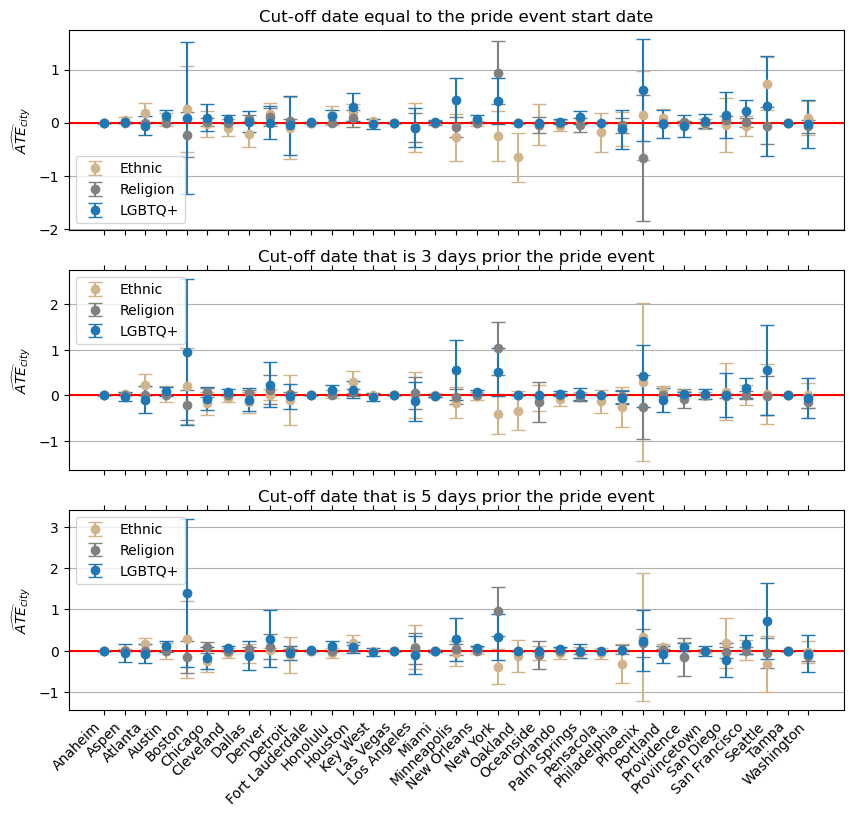

In [84]:
fig = plt.figure(figsize=(10,10))

plt.subplot(3,1,1)

plt.errorbar(lates_cityagg_14_a0.index.values, lates_cityagg_14_a0["late_ethno"],
             yerr=(lates_cityagg_14_a0["late_ethno"] - lates_cityagg_14_a0["late_cil_ethno"]).values,
             marker='o', label='Ethnic', capsize=5, linestyle='none', color='tan')
plt.errorbar(lates_cityagg_14_a0.index.values, lates_cityagg_14_a0["late_relig"],
             yerr=(lates_cityagg_14_a0["late_relig"] - lates_cityagg_14_a0["late_cil_relig"]).values,
             marker='o', label='Religion', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a0.index.values, lates_cityagg_14_a0["late"],
             yerr=(lates_cityagg_14_a0["late"] - lates_cityagg_14_a0["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
# fig.autofmt_xdate(rotation=45)
plt.legend(loc='lower left')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.title('Cut-off date equal to the pride event start date')
# plt.savefig(os.path.join(graphs_path, 'percity_RD14_a0.png'), bbox_inches="tight")
plt.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=False)
plt.grid(which='major', axis='y')
# fig = plt.figure(figsize=(10,3))
plt.subplot(3,1,2)


plt.errorbar(lates_cityagg_14_a3.index.values, lates_cityagg_14_a3["late_ethno"],
             yerr=(lates_cityagg_14_a3["late_ethno"] - lates_cityagg_14_a3["late_cil_ethno"]).values,
             marker='o', label='Ethnic', capsize=5, linestyle='none', color='tan')
plt.errorbar(lates_cityagg_14_a3.index.values, lates_cityagg_14_a3["late_relig"],
             yerr=(lates_cityagg_14_a3["late_relig"] - lates_cityagg_14_a3["late_cil_relig"]).values,
             marker='o', label='Religion', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a3.index.values, lates_cityagg_14_a3["late"],
             yerr=(lates_cityagg_14_a3["late"] - lates_cityagg_14_a3["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
# fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper left')
plt.ylabel('$\widehat{ATE}_{city}$')
# plt.savefig(os.path.join(graphs_path, 'percity_RD14_a3.png'), bbox_inches="tight")
plt.title('Cut-off date that is 3 days prior the pride event')
plt.tick_params(axis='x', which='both', bottom=True, top=True, labelbottom=False)
plt.grid(which='major', axis='y')

plt.subplot(3,1,3)

# fig = plt.figure(figsize=(10,3))
plt.tick_params(axis='x', which='both', bottom=True, top=True, labelbottom=True)
plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late_ethno"],
             yerr=(lates_cityagg_14_a5["late_ethno"] - lates_cityagg_14_a5["late_cil_ethno"]).values,
             marker='o', label='Ethnic', capsize=5, linestyle='none', color='tan')
plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late_relig"],
             yerr=(lates_cityagg_14_a5["late_relig"] - lates_cityagg_14_a5["late_cil_relig"]).values,
             marker='o', label='Religion', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late"],
             yerr=(lates_cityagg_14_a5["late"] - lates_cityagg_14_a5["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper left')
plt.grid(which='major', axis='y')

plt.ylabel('$\widehat{ATE}_{city}$')
plt.title('Cut-off date that is 5 days prior the pride event')

plt.savefig(os.path.join(graphs_path, 'percity_RD14_a0a3a5.png'), bbox_inches="tight")

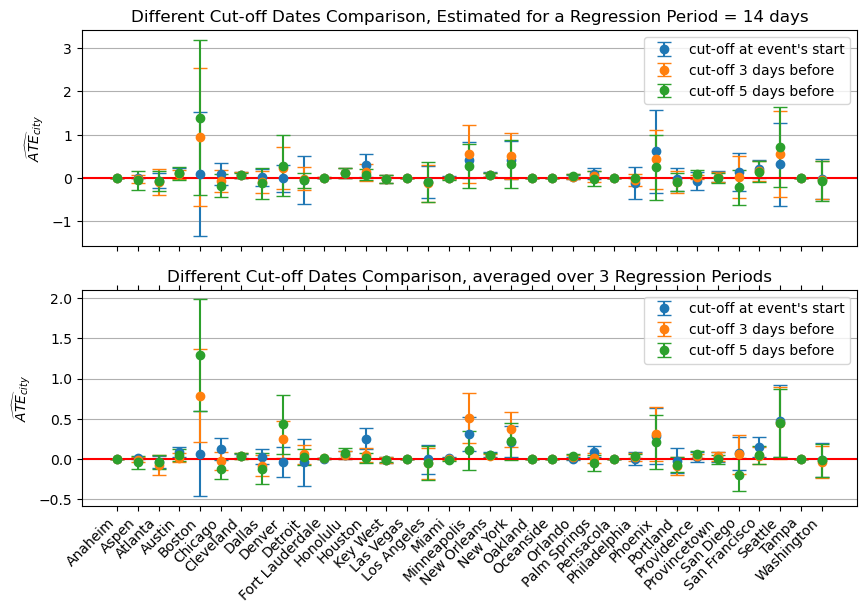

In [85]:
fig = plt.figure(figsize=(10,7))

plt.subplot(2,1,1)
plt.errorbar(lates_cityagg_14_a0.index.values, lates_cityagg_14_a0["late"],
             yerr=(lates_cityagg_14_a0["late"] - lates_cityagg_14_a0["late_cil"]).values,
             marker='o', label='cut-off at event\'s start', capsize=5, linestyle='none')

plt.errorbar(lates_cityagg_14_a3.index.values, lates_cityagg_14_a3["late"],
             yerr=(lates_cityagg_14_a3["late"] - lates_cityagg_14_a3["late_cil"]).values,
             marker='o', label='cut-off 3 days before', capsize=5, linestyle='none')

plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late"],
             yerr=(lates_cityagg_14_a5["late"] - lates_cityagg_14_a5["late_cil"]).values,
             marker='o', label='cut-off 5 days before', capsize=5, linestyle='none')


plt.axhline(y=0, color='r', linestyle='-')
# fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.title('Different Cut-off Dates Comparison, Estimated for a Regression Period = 14 days')
plt.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=False)
plt.grid(which='major', axis='y')

# plt.savefig(os.path.join(graphs_path, 'percity_RD14.png'), bbox_inches="tight")
plt.subplot(2,1,2)

# fig = plt.figure(figsize=(10,3))
plt.errorbar(lates_city_agg_avg_a0.index.values, lates_city_agg_avg_a0["late"],
             yerr=(lates_city_agg_avg_a0["late"] - lates_city_agg_avg_a0["late_cil"]).values,
             marker='o', label='cut-off at event\'s start', capsize=5, linestyle='none')

plt.errorbar(lates_city_agg_avg_a3.index.values, lates_city_agg_avg_a3["late"],
             yerr=(lates_city_agg_avg_a3["late"] - lates_city_agg_avg_a3["late_cil"]).values,
             marker='o', label='cut-off 3 days before', capsize=5, linestyle='none')

plt.errorbar(lates_city_agg_avg_a5.index.values, lates_city_agg_avg_a5["late"],
             yerr=(lates_city_agg_avg_a5["late"] - lates_city_agg_avg_a5["late_cil"]).values,
             marker='o', label='cut-off 5 days before', capsize=5, linestyle='none')
plt.tick_params(axis='x', which='both', bottom=True, top=True, labelbottom=True)
plt.title('Different Cut-off Dates Comparison, averaged over 3 Regression Periods')
plt.grid(which='major', axis='y')

plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend()
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_d14andRDavg.png'), bbox_inches="tight")

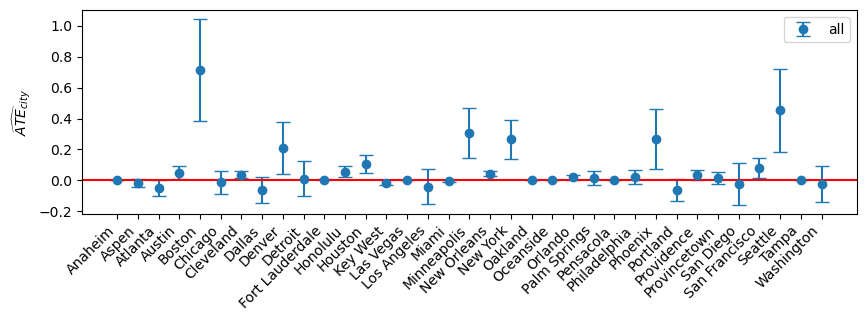

In [86]:
fig = plt.figure(figsize=(10,3))
plt.errorbar(lates_city_agg_avg_all.index.values, lates_city_agg_avg_all["late"],
             yerr=(lates_city_agg_avg_all["late"] - lates_city_agg_avg_all["late_cil"]).values,
             marker='o', label='all', capsize=5, linestyle='none')

plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend()
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity.png'), bbox_inches="tight")

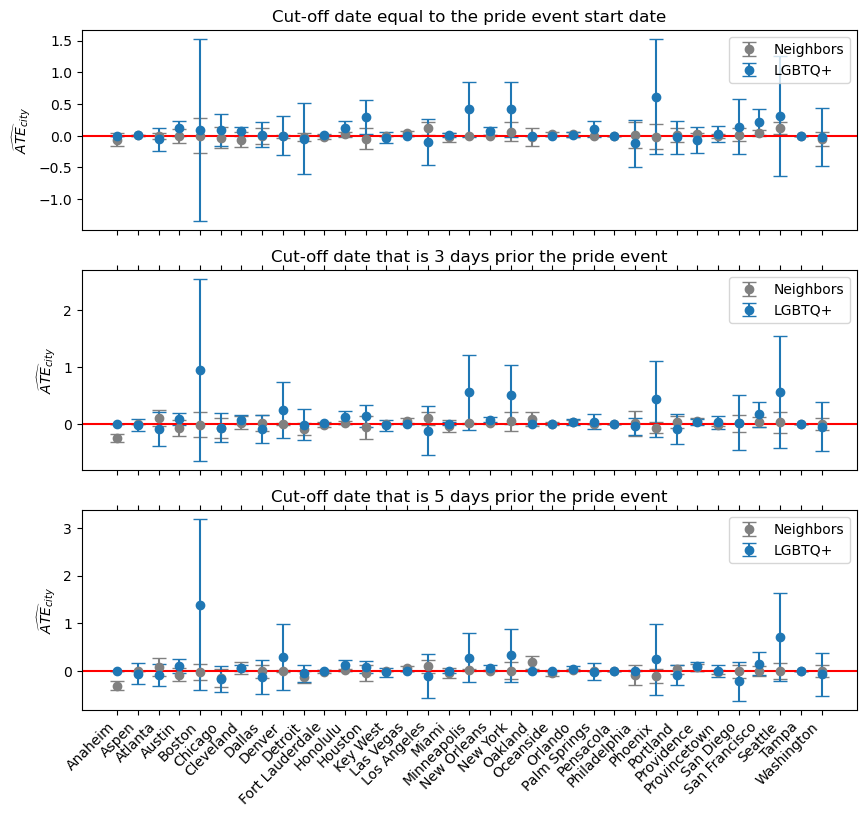

In [87]:
fig = plt.figure(figsize=(10,10))

plt.subplot(3,1,1)
plt.errorbar(lates_cityagg_14_a0_nn.index.values, lates_cityagg_14_a0_nn["late_neigh"],
             yerr=(lates_cityagg_14_a0_nn["late_neigh"] - lates_cityagg_14_a0_nn["late_cil_neigh"]).values,
             marker='o', label='Neighbors', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a0_nn.index.values, lates_cityagg_14_a0_nn["late"],
             yerr=(lates_cityagg_14_a0_nn["late"] - lates_cityagg_14_a0_nn["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
# fig.autofmt_xdate(rotation=45)
plt.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=False)
plt.title('Cut-off date equal to the pride event start date')
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
# plt.savefig(os.path.join(graphs_path, 'percity_RD14_a0_nn.png'), bbox_inches="tight")

# fig = plt.figure(figsize=(10,3))
plt.subplot(3,1,2)
plt.errorbar(lates_cityagg_14_a3_nn.index.values, lates_cityagg_14_a3_nn["late_neigh"],
             yerr=(lates_cityagg_14_a3_nn["late_neigh"] - lates_cityagg_14_a3_nn["late_cil_neigh"]).values,
             marker='o', label='Neighbors', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a3_nn.index.values, lates_cityagg_14_a3_nn["late"],
             yerr=(lates_cityagg_14_a3_nn["late"] - lates_cityagg_14_a3_nn["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
# fig.autofmt_xdate(rotation=45)
plt.tick_params(axis='x', which='both', bottom=True, top=True, labelbottom=False)
plt.title('Cut-off date that is 3 days prior the pride event')

plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
# plt.savefig(os.path.join(graphs_path, 'percity_RD14_a3_nn.png'), bbox_inches="tight")

# fig = plt.figure(figsize=(10,3))
plt.subplot(3,1,3)

plt.errorbar(lates_cityagg_14_a5_nn.index.values, lates_cityagg_14_a5_nn["late_neigh"],
             yerr=(lates_cityagg_14_a5_nn["late_neigh"] - lates_cityagg_14_a5_nn["late_cil_neigh"]).values,
             marker='o', label='Neighbors', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late"],
             yerr=(lates_cityagg_14_a5["late"] - lates_cityagg_14_a5["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.tick_params(axis='x', which='both', bottom=True, top=True, labelbottom=True)

plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.title('Cut-off date that is 5 days prior the pride event')

plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RD14_a0a3a5_nn.png'), bbox_inches="tight")
# plt.savefig(os.path.join(graphs_path, 'percity_RD14_a5_nn.png'), bbox_inches="tight")


### Seperate Graphs

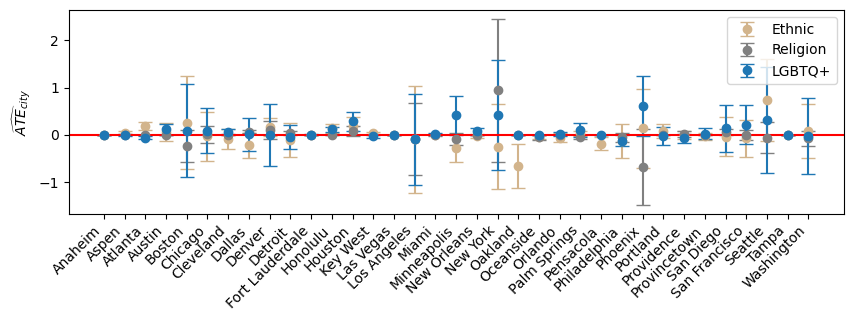

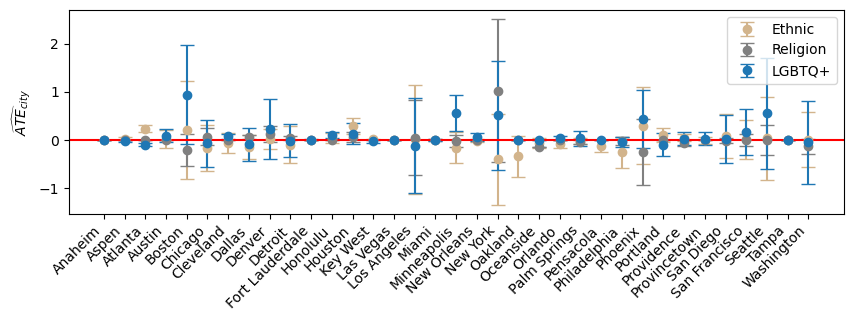

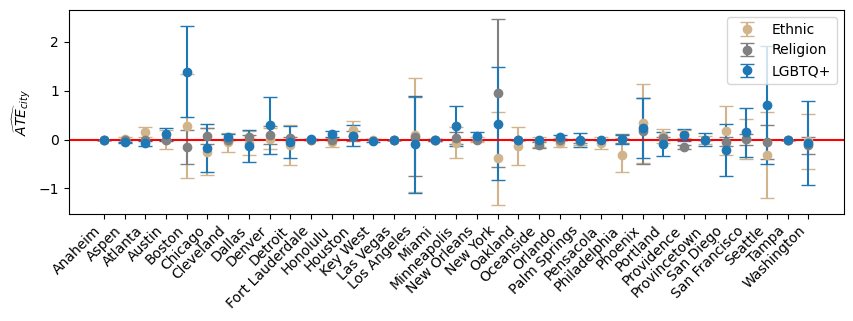

In [335]:
fig = plt.figure(figsize=(10,3))

plt.errorbar(lates_cityagg_14_a0.index.values, lates_cityagg_14_a0["late_ethno"],
             yerr=(lates_cityagg_14_a0["late_ethno"] - lates_cityagg_14_a0["late_cil_ethno"]).values,
             marker='o', label='Ethnic', capsize=5, linestyle='none', color='tan')
plt.errorbar(lates_cityagg_14_a0.index.values, lates_cityagg_14_a0["late_relig"],
             yerr=(lates_cityagg_14_a0["late_relig"] - lates_cityagg_14_a0["late_cil_relig"]).values,
             marker='o', label='Religion', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a0.index.values, lates_cityagg_14_a0["late"],
             yerr=(lates_cityagg_14_a0["late"] - lates_cityagg_14_a0["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RD14_a0.png'), bbox_inches="tight")

fig = plt.figure(figsize=(10,3))

plt.errorbar(lates_cityagg_14_a3.index.values, lates_cityagg_14_a3["late_ethno"],
             yerr=(lates_cityagg_14_a3["late_ethno"] - lates_cityagg_14_a3["late_cil_ethno"]).values,
             marker='o', label='Ethnic', capsize=5, linestyle='none', color='tan')
plt.errorbar(lates_cityagg_14_a3.index.values, lates_cityagg_14_a3["late_relig"],
             yerr=(lates_cityagg_14_a3["late_relig"] - lates_cityagg_14_a3["late_cil_relig"]).values,
             marker='o', label='Religion', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a3.index.values, lates_cityagg_14_a3["late"],
             yerr=(lates_cityagg_14_a3["late"] - lates_cityagg_14_a3["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RD14_a3.png'), bbox_inches="tight")

fig = plt.figure(figsize=(10,3))
plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late_ethno"],
             yerr=(lates_cityagg_14_a5["late_ethno"] - lates_cityagg_14_a5["late_cil_ethno"]).values,
             marker='o', label='Ethnic', capsize=5, linestyle='none', color='tan')
plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late_relig"],
             yerr=(lates_cityagg_14_a5["late_relig"] - lates_cityagg_14_a5["late_cil_relig"]).values,
             marker='o', label='Religion', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late"],
             yerr=(lates_cityagg_14_a5["late"] - lates_cityagg_14_a5["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RD14_a5.png'), bbox_inches="tight")

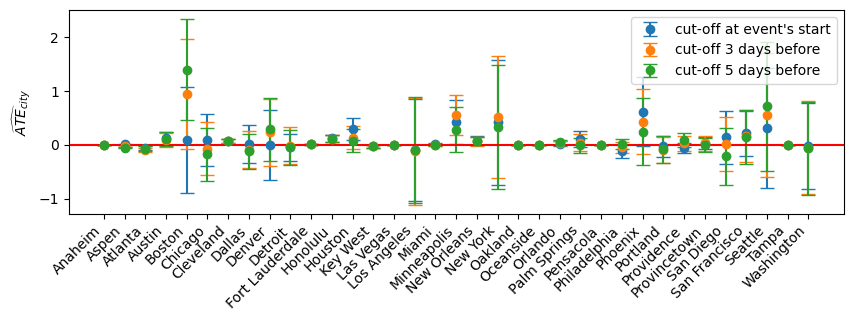

In [336]:
fig = plt.figure(figsize=(10,3))
plt.errorbar(lates_cityagg_14_a0.index.values, lates_cityagg_14_a0["late"],
             yerr=(lates_cityagg_14_a0["late"] - lates_cityagg_14_a0["late_cil"]).values,
             marker='o', label='cut-off at event\'s start', capsize=5, linestyle='none')

plt.errorbar(lates_cityagg_14_a3.index.values, lates_cityagg_14_a3["late"],
             yerr=(lates_cityagg_14_a3["late"] - lates_cityagg_14_a3["late_cil"]).values,
             marker='o', label='cut-off 3 days before', capsize=5, linestyle='none')

plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late"],
             yerr=(lates_cityagg_14_a5["late"] - lates_cityagg_14_a5["late_cil"]).values,
             marker='o', label='cut-off 5 days before', capsize=5, linestyle='none')


plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RD14.png'), bbox_inches="tight")

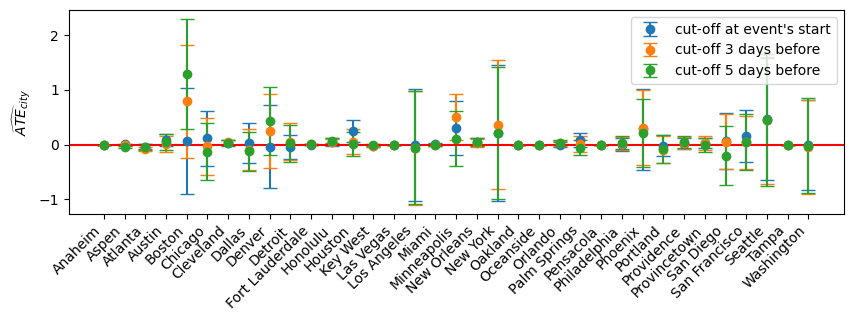

In [337]:
lates_city_agg_avg_a0 = (lates_cityagg_5_a0 + lates_cityagg_10_a0 + lates_cityagg_14_a0)/3
lates_city_agg_avg_a3 = (lates_cityagg_5_a3 + lates_cityagg_10_a3 + lates_cityagg_14_a3)/3
lates_city_agg_avg_a5 = (lates_cityagg_5_a5 + lates_cityagg_10_a5 + lates_cityagg_14_a5)/3

fig = plt.figure(figsize=(10,3))
plt.errorbar(lates_city_agg_avg_a0.index.values, lates_city_agg_avg_a0["late"],
             yerr=(lates_city_agg_avg_a0["late"] - lates_city_agg_avg_a0["late_cil"]).values,
             marker='o', label='cut-off at event\'s start', capsize=5, linestyle='none')

plt.errorbar(lates_city_agg_avg_a3.index.values, lates_city_agg_avg_a3["late"],
             yerr=(lates_city_agg_avg_a3["late"] - lates_city_agg_avg_a3["late_cil"]).values,
             marker='o', label='cut-off 3 days before', capsize=5, linestyle='none')

plt.errorbar(lates_city_agg_avg_a5.index.values, lates_city_agg_avg_a5["late"],
             yerr=(lates_city_agg_avg_a5["late"] - lates_city_agg_avg_a5["late_cil"]).values,
             marker='o', label='cut-off 5 days before', capsize=5, linestyle='none')

plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend()
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RDavg.png'), bbox_inches="tight")

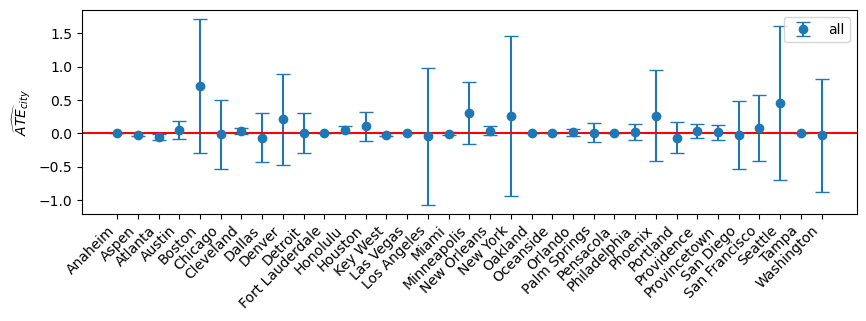

In [338]:
lates_city_agg_avg_all = (lates_city_agg_avg_a0 + lates_city_agg_avg_a3 + lates_city_agg_avg_a5)/3

fig = plt.figure(figsize=(10,3))
plt.errorbar(lates_city_agg_avg_all.index.values, lates_city_agg_avg_all["late"],
             yerr=(lates_city_agg_avg_all["late"] - lates_city_agg_avg_all["late_cil"]).values,
             marker='o', label='all', capsize=5, linestyle='none')

plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend()
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity.png'), bbox_inches="tight")

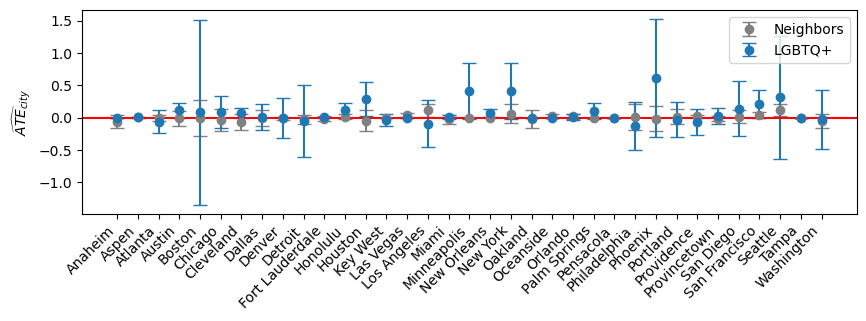

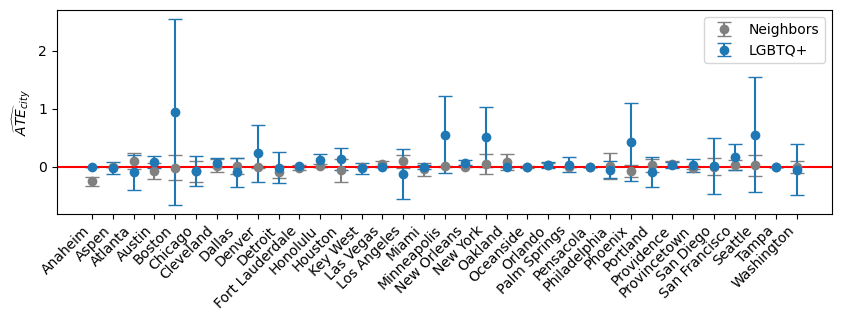

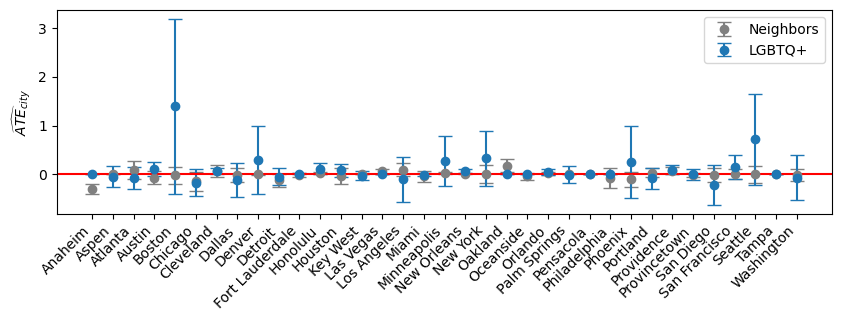

In [78]:
fig = plt.figure(figsize=(10,3))

plt.errorbar(lates_cityagg_14_a0_nn.index.values, lates_cityagg_14_a0_nn["late_neigh"],
             yerr=(lates_cityagg_14_a0_nn["late_neigh"] - lates_cityagg_14_a0_nn["late_cil_neigh"]).values,
             marker='o', label='Neighbors', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a0_nn.index.values, lates_cityagg_14_a0_nn["late"],
             yerr=(lates_cityagg_14_a0_nn["late"] - lates_cityagg_14_a0_nn["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RD14_a0_nn.png'), bbox_inches="tight")

fig = plt.figure(figsize=(10,3))
plt.errorbar(lates_cityagg_14_a3_nn.index.values, lates_cityagg_14_a3_nn["late_neigh"],
             yerr=(lates_cityagg_14_a3_nn["late_neigh"] - lates_cityagg_14_a3_nn["late_cil_neigh"]).values,
             marker='o', label='Neighbors', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a3_nn.index.values, lates_cityagg_14_a3_nn["late"],
             yerr=(lates_cityagg_14_a3_nn["late"] - lates_cityagg_14_a3_nn["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RD14_a3_nn.png'), bbox_inches="tight")

fig = plt.figure(figsize=(10,3))
plt.errorbar(lates_cityagg_14_a5_nn.index.values, lates_cityagg_14_a5_nn["late_neigh"],
             yerr=(lates_cityagg_14_a5_nn["late_neigh"] - lates_cityagg_14_a5_nn["late_cil_neigh"]).values,
             marker='o', label='Neighbors', capsize=5, linestyle='none', color='gray')
plt.errorbar(lates_cityagg_14_a5.index.values, lates_cityagg_14_a5["late"],
             yerr=(lates_cityagg_14_a5["late"] - lates_cityagg_14_a5["late_cil"]).values,
             marker='o', label='LGBTQ+', capsize=5, linestyle='none')
plt.axhline(y=0, color='r', linestyle='-')
fig.autofmt_xdate(rotation=45)
plt.legend(loc='upper right')
plt.ylabel('$\widehat{ATE}_{city}$')
plt.savefig(os.path.join(graphs_path, 'percity_RD14_a5_nn.png'), bbox_inches="tight")

### Table

In [90]:
lates_city_agg_avg_all[["late", "late_cil", "late_cih", "late_pval_mean"]].round(decimals=4)

,late,late_cil,late_cih,late_pval_mean
city,,,,
Anaheim,0.0000,0.0000,0.0000,0.0000
Aspen,-0.0159,-0.0425,-0.0020,0.0086
Atlanta,-0.0530,-0.1046,-0.0240,0.0209
Austin,0.0488,0.0077,0.1026,0.1023
Boston,0.7135,0.3836,1.0074,0.1629
Chicago,-0.0128,-0.0875,0.0648,0.2023
Cleveland,0.0369,0.0130,0.0721,0.0323
Dallas,-0.0623,-0.1470,0.0140,0.1893
Denver,0.2122,0.0438,0.4027,0.2553


In [94]:
all_db = pd.concat([lates_agg_5_a0, lates_agg_10_a0, lates_agg_14_a0,
                    lates_agg_5_a3, lates_agg_10_a3, lates_agg_14_a3,
                    lates_agg_5_a5, lates_agg_10_a5, lates_agg_14_a5])
all_mean = all_db['late'].mean()
all_late = bootstrap((all_db["late"].values,), np.mean, confidence_level=0.95, random_state=1)
all_cilh = (all_late.confidence_interval.low, all_late.confidence_interval.high)
all_late_pval = combine_pvalues(all_db["late_pval"].values)[1]
all_late_pval_mean = all_db['late_pval'].mean()

print(f'Total:\nLATE: {all_mean:.3f} in [{all_cilh[0]:.3f}, {all_cilh[1]:.3f}], '
      f'pval fischer:{all_late_pval:.4f}, pval mean: {all_late_pval_mean:.3f}')
# lates_city_agg_avg_all[["late", "late_cil", "late_cih", "late_pval"]].round(decimals=3).mean()

Total:
LATE: 0.052 in [0.034, 0.071], pval fischer:0.000, pval mean: 0.113


# NN

In [31]:
def get_nn_city(state_char_DB, gay_events_db, hc_db, city_gdp_data,
                cur_city,
                cur_state, 
                date_begin, date_end, 
                time_delta, n_neighbors=5):
    """calculate the n_neighbors that are the most similar to the given (city, state) pair 
    relative to the features DB given, that DO NOT have a pride event occouring at the same time as the given date."""
    
    def replace_city_gdp(row):
        city_gdp = city_gdp_data[(city_gdp_data['city_name'] == row['pug_agency_name']) &
                                 (city_gdp_data['State'] == abbrev_to_us_state[row['state_abbr']]) &
                                 (date_begin.year == city_gdp_data["year"])]
        if len(city_gdp):
            return city_gdp["gdp"].mean()
        else:
            return row["gdp"]
        
    def get_per_city_features(x):
        try:
            return us_cities[(us_cities['city_ascii'] == x['pug_agency_name']) &
                                (us_cities['state_id'] == x['state_abbr'])].iloc[0,:][["density","population"]]
        except IndexError:
            # This means that the city is small
            # So if in all of the hate crimes database, this city appeared only once - drop it
            if len(hc_db[(hc_db['pug_agency_name'] == x['pug_agency_name']) & (hc_db['state_abbr'] == x['state_abbr'])]) > 1:
                raise
    
    # Find other cities that have pride events in the same time
    forbidden_cities = gay_events_db.loc[
        (gay_events_db["location"] != cur_city) &
        (date_begin - time_delta <= gay_events_db["start_date"]) & 
        (gay_events_db["end_date"] <= date_end + time_delta)][["location", "state_id"]].drop_duplicates().values
    
    # Select from the features database only the relevant dates (optimize runtime)
    relevant_char_DB = state_char_DB[(date_begin - time_delta <= state_char_DB["Date"]) &
                               (state_char_DB["Date"] <= date_end + time_delta)
                              ].groupby(by=['State']).mean(numeric_only=True)
    
    # Get cities that had hatecrimes stats recorded, 
    # make sure to not select forbidden cities (that had pride events in the given dates)
    hc_cities = hc_db[["pug_agency_name", "state_abbr"]].drop_duplicates()
    ok_cities = hc_cities[~hc_cities.apply(
        lambda x: (x[["pug_agency_name", "state_abbr"]].values == forbidden_cities
                  ).all(axis=1).any(), axis=1)]

    # copy the state features to each city (we assume that in the given dates the features don't change much)
    ok_cities_states_data = pd.concat([ok_cities, ok_cities.apply(
        lambda x: relevant_char_DB[relevant_char_DB.index == abbrev_to_us_state[x['state_abbr']]].iloc[0,:], axis=1)],
                                      axis=1)
    
    ok_cities_city_data = pd.concat([ok_cities_states_data, ok_cities_states_data.apply(get_per_city_features, axis=1)],
                                    axis=1, ignore_index=False)
    # Remove cities that don't have population and density data (small cities with only 1 hate crime...)
    ok_cities_city_data = ok_cities_city_data[pd.notna(ok_cities_city_data.population)]

    
#     Add GDP at the city level if possible
#     ok_cities_city_data["gdp"] = ok_cities_city_data.apply(replace_city_gdp , axis=1)
    
#     return ok_cities_city_data
    # Get ready to drop irelevant features for NN matching
    irlv_feat = ["GayFriendScore_unNorm", "special", "totalvotes_presid", "totalvotes_senate",
                 "Other_candidatevotes_senate", "Other_candidatevotes_presid",
                 "Republican_candidatevotes_senate", "Republican_candidatevotes_presid",
                 "Democrat_candidatevotes_senate", "Democrat_candidatevotes_presid",
                 "Libertarian_candidatevotes_senate", "Libertarian_candidatevotes_presid",
                 "state_abbr", "pug_agency_name", "gdp"]
    
    # norm population and density acording to chosen cities
    ok_cities_city_data['density'] = ((ok_cities_city_data['density'] - ok_cities_city_data['density'].min()) /
                                      (ok_cities_city_data['density'].max() - ok_cities_city_data['density'].min()))
    ok_cities_city_data['population'] = ((ok_cities_city_data['population'] - ok_cities_city_data['population'].min()) /
                                      (ok_cities_city_data['population'].max() - ok_cities_city_data['population'].min()))
#     ok_cities_city_data['gdp'] = ((ok_cities_city_data['gdp'] - ok_cities_city_data['gdp'].min()) /
#                                       (ok_cities_city_data['gdp'].max() - ok_cities_city_data['gdp'].min()))
    
    # Split the cities data
    cur_city_data = ok_cities_city_data[(ok_cities_city_data['state_abbr'] == cur_state) &
                                        (ok_cities_city_data['pug_agency_name'] == cur_city)]
    ok_cities_city_data = ok_cities_city_data[(ok_cities_city_data['state_abbr'] != cur_state) |
                                              (ok_cities_city_data['pug_agency_name'] != cur_city)]
    
    # Define NN
    nn = KNeighborsClassifier(n_neighbors=n_neighbors)
    labels = ok_cities_city_data[["state_abbr","pug_agency_name"]].values
    nn.fit(ok_cities_city_data[ok_cities_city_data.columns.drop(irlv_feat)].values, labels)
    
    distances, indices = nn.kneighbors(cur_city_data[cur_city_data.columns.drop(irlv_feat)].values)
    
    return distances, labels[indices], forbidden_cities

In [32]:
nn_folder_path = os.path.join('Data', 'NearestNeighbors')
os.makedirs(nn_folder_path, exist_ok=True)
nn_path = os.path.join(nn_folder_path,
                       f'nn_{RD_PERIOD}.xlsx')



# If the NN data doesn't exist in the folder, create it
if not os.path.exists(nn_path):
    forbidden_cities_arr = []
    tmp_nn_data = []
    
    for i, event in tqdm(filt_gay_events.iterrows(), total=len(filt_gay_events)):
#         aefaefafe = get_nn_city(
        nns_dist, nns_labels, _ = get_nn_city(
            state_char_DB,
            filt_gay_events,
            agg_hate_crimes,
            gdp_data_cities,
            event['location'],
            event['state_id'],
            event['start_date'],
            event['end_date'],
            datetime.timedelta(days=RD_PERIOD))
        
        tmp_nn_data.append([*nns_labels.reshape(-1),
                            *nns_dist.reshape(-1)])
    tmp_nn_data = pd.DataFrame(tmp_nn_data, columns=["nn1_state",
                                                     "nn1_city",
                                                     "nn2_state",
                                                     "nn2_city",
                                                     "nn3_state",
                                                     "nn3_city",
                                                     "nn4_state",
                                                     "nn4_city",
                                                     "nn5_state",
                                                     "nn5_city",
                                                     "nn1_dist",
                                                     "nn2_dist",
                                                     "nn3_dist",
                                                     "nn4_dist",
                                                     "nn5_dist",
                                                ])
    filt_gay_events_nn = pd.concat([filt_gay_events, tmp_nn_data], axis=1)
    filt_gay_events_nn.to_excel(nn_path)
else:
    filt_gay_events_nn = pd.read_excel(nn_path)

In [33]:
filt_gay_events_nn

,Unnamed: 0,location,start_date,end_date,description,state_id,state_name,county_name,lat,lng,...,nn3_city,nn4_state,nn4_city,nn5_state,nn5_city,nn1_dist,nn2_dist,nn3_dist,nn4_dist,nn5_dist
0,0,Miami,2006-11-22,2006-11-27,White Party Week,FL,Florida,Miami-Dade,25.7840,-80.2101,...,Phoenix,FL,Hialeah,FL,Miami Beach,0.249519,0.299657,0.304324,0.314963,0.321269
1,1,Aspen,2007-01-14,2007-01-21,Gay and Lesbian Ski Week,CO,Colorado,Pitkin,39.1951,-106.8369,...,Fort Morgan,CO,Golden,CO,La Junta,0.001889,0.001934,0.002254,0.002299,0.003173
2,2,Miami,2007-01-28,2007-02-04,Freedom Caribbean Cruise,FL,Florida,Miami-Dade,25.7840,-80.2101,...,Phoenix,FL,Hialeah,PA,Philadelphia,0.249519,0.299657,0.301850,0.314963,0.319523
3,3,Miami,2007-02-28,2007-03-05,Winter Party,FL,Florida,Miami-Dade,25.7840,-80.2101,...,Phoenix,FL,Hialeah,PA,Philadelphia,0.249519,0.299657,0.301850,0.314963,0.319523
4,4,Orlando,2007-05-29,2007-06-04,Gay Days Reunion Weekend,FL,Florida,Orange,28.4773,-81.3370,...,Sarasota,FL,Cape Coral,FL,Palm Bay,0.042316,0.055096,0.062471,0.062947,0.073293
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
682,682,Los Angeles,2021-09-17,2021-09-19,Gay Days Anaheim,CA,California,Los Angeles,34.1141,-118.4068,...,San Francisco,CA,Riverside,CA,Sacramento,0.468012,0.506682,0.517295,0.563986,0.573574
683,683,Las Vegas,2021-10-08,2021-10-09,Las Vegas Pride,NV,Nevada,Clark,36.2333,-115.2654,...,North Las Vegas,NV,Sparks,NV,Elko,0.101512,0.103951,0.110069,0.115072,0.131504
684,684,Los Angeles,2021-10-31,2021-11-07,Atlantis LA Mexico gay cruise,CA,California,Los Angeles,34.1141,-118.4068,...,San Francisco,CA,Riverside,CA,Sacramento,0.468012,0.506682,0.517295,0.563986,0.573574
685,685,Fort Lauderdale,2021-11-20,2021-11-21,Pride Fort Lauderdale,FL,Florida,Broward,26.1412,-80.1464,...,Coconut Creek,FL,Miramar,FL,Daytona Beach Shores,0.006103,0.007378,0.007484,0.007649,0.009669
